<a href="https://colab.research.google.com/github/duchaba/aud3_augmentation_data_deep_dive/blob/main/AUD3_augmentation_data_deep_dive.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# OPTIONAL
# For Google Colab, (1) Open the "concole", e.g. right-click and inspect, (2) Copy the below scripts (from line #10 to #17) and run it.
#
# If you know how to hack Google Colab Jupyter notebook and run "javascripts" as-is below, 
#i.e., without the need for opening up the console, please share it with me.
#
# The Javascript is to highlight the code cells' input and output and the code-cells you have executed.
#
%%js
var head = document.head || document.getElementsByTagName("head")[0];
var style = document.createElement("style");
var css = ".inputarea.code{border-left: 4px solid #20c997;}.cell.focused .inputarea.code{border-left: 4px solid #d63384;}.cell .output{border-left: 4px solid #ffc107;}";
css = css + ":root { --colab-fresh-execution-count-color: #d63384;}";
css = css + ".markdown blockquote {border-left: 10px solid #fd7e14 !important;border-radius: 10px 0 0 10px;padding: 1em 1em 1em 1em;border-bottom: 1px solid #343845}"
css = css + " h1,h2,h3,h4,h5 {font-family:serif !important;}"
css = css + "h1{color:#e83e8c !important;;} h2{color:#20c997 !important;font-size:120%;} h3{color:#fd7e14 !important;font-size:120%;} h4{color:#6610f2 !important;}"
head.appendChild(style);
style.type = "text/css";
style.appendChild(document.createTextNode(css));


<IPython.core.display.Javascript object>

# 1.0 |-- Introduction | Augmentation Data Deep Dive (AUD3)

Welcome to the “Augmentation Data Deep Dive” (AUD3) project. It is another journey in the “Demystify AI” series. 

The only thing these journeys have in common is the problems are taken from the real-world Artificial Neural Network (ANN) project. I have worked on them, coded them, cried over them, and sometimes had a flash-of-insight or an original thought about them.

The journeys are a fun and fascinating insight into the daily working of an AI Scientist and Big-Data Scientist. They are for colleagues and AI students, but I hope that you, a gentle reader, would enjoy it too. 

The logic behind data augmentation is uncomplicated. You need more pictures to increase the ANN model accuracy, and data augmentation gives you more images. 

The AUD3 is a hackable, step-by-step Jupyter Notebook. It is for learning about data augmentation and selecting the correct parameters in the ANN image-classification and image-segmentation projects. You can skip ahead to the result-cells and not read the math and the code-cells. The math is elementary, and coding is straightforward logic, so try it out. You might enjoy “hacking” along the journey. 

Data augmentation increases the training images by a factor of 2 to 16 or more. For ANN, that means the model achieves better accuracy with more epoch and without over-fitting. 

For example, I was working on an AI project for a large casino hotel. The goal is to classify every customer into one of the 16 categories as they walk through the door. In other words, it is not to identify that guy walking through the door is “Duc Haba,” but to classify him as a “whale (A-1)” category, i.e., a big spender. 

As you have guessed, the first and most significant problem is the lack of labeled pictures. I need millions of tagged photos because of human diversity in race, ethnicity, clothing, different camera angle, and so on. 

ANN is not a ruled-based expert system. For example, a person wearing a Rolex watch is an “A-1”, or a guy with no shoe and no shirt is a “D-4” category. ANN does not use rules, so it needs millions of labeled images to train and to generalize so the ANN model can classify a guy who enters the casino for the first time correctly. In ANN’s lingual, it means the ANN model is not over-fitting. 

I classify the AUD3 as a "sandbox" project. In other words, it is a fun, experimental project focusing on solving one problem.






><center><h2><i>So if you are ready, let's take a collective calming breath …  … and begin.</i></h2></center>

# 2.0 |-- The Journey




- As with the previous journey, the first step is to choose and name your dog companion. With the project code name AUD3, the natural name has to be “Wallaby.” 

- Typically a dog name is chosen, e.g., "Lefty," "Roosty," or "Eggna," but be warned, don't name it after your cat because a "cat" will not follow any commands.

- If you are serious about learning augmenting data, start hacking by changing the companion name to your preference. Jupyter notebook allows you to add notes, add new codes, and hack Wallaby’s code. 

- If you are a friend tagging along, you will like Wallaby. He is a friendly, helpful dog. He will do all the tedious work in good spirits, and he likes to hop around. 

- As a good little programmer, Wallaby (or insert your companion name here) starts by creating an object or class.

![wallaby](https://github.com/duchaba/aud3_augmentation_data_deep_dive/blob/main/wallaby3.jpg?raw=true)

## 2.1 | Wallaby's "River" Coding Style

- Wallaby uses the "river" coding style.

- The style uses a full library name, sub-class, and following by the function name. Jupyter notebook has auto-complete, so Wallaby would not misspell long variable and function name. 

- Wallaby is NOT using the global-space, such as "import numpy *" or using the shorten name like "import matplotlib.pyplot as ptl.” Instead he is using the full {river} name as in “numpy.random.randint().”

- Furthermore, Wallaby shies away from using Python language-specific syntax shorthand, such as the “assigned if” statement construct. He likes to write the Python code using standard Python libraries and not relying on exotic packages. 

- The primary reason for using the “river” coding style coupled with a descriptive naming convention is that it is easier to read, hack, and translate to Swift or Javascript.

- For any sandbox project, Wallaby is in the exploration mode, and therefore, he will refactor and optimize the code afterward. When Wallaby using [Atom IDE](htpps://atom.io) to upload the code to GitHub, he may refactor them to make them run faster, but not for syntax compaction or syntax shorthand. 


## 2.2 | Wallaby Class

In [1]:
# import standard libraries
import numpy
import pathlib
import os
import pandas
import matplotlib

In [25]:
class AUD3(object):
  #
  # initialize the object
  def __init__(self, name="Wallaby"):
    self.author = "Duc Haba"
    self.name = name
    self._ph()
    self._pp("Hello from", self.__class__.__name__)
    self._pp("Code name", self.name)
    self._pp("Author is", self.author)
    self._ph()
    return
  #
  # pretty print output name-value line
  def _pp(self, a, b):
    print("%40s : %s" % (str(a), str(b)))
    return
  #
  # pretty print the header or footer lines
  def _ph(self):
    print("-" * 40, ":", "-" * 40)
    return
  #
  # dance
  def dance_happy(self):
    char = "        _=,_\n    o_/6 /#\\\n    \\__ |##/\n     ='|--\\\n       /   #'-.\n"
    char = char + "       \\#|_   _'-. /\n        |/ \\_( # |\" \n       C/ ,--___/\n"
    print(char)
    self._ph()
    return
  # 
  # draw black sheep
  def draw_black_sheep(self):
    c = "\n_________________       _       _       _       _       _       _       _ \n"
    c = c + "______________-(_)-  _-(_)-  _-(_)-  _-(\")-  _-(_)-  _-(_)-  _-(_)-  _-(_)- \n"
    c = c + "___________`(___)  `(___)  `(___)  `(###)  `(___)  `(___)  `(___)  `(___) \n"
    c = c + "____________// \\\\   // \\\\   // \\\\   // \\\\   // \\\\   // \\\\   // \\\\   // \\\\ \n" 
    print(c) 
    self._ph()
    self._pp("bye'aaa", "bye'aaa")
    return
# ---end of AUD3 class

In [26]:
# Let start
wallaby = AUD3("Wallaby")

---------------------------------------- : ----------------------------------------
                              Hello from : AUD3
                               Code name : Wallaby
                               Author is : Duc Haba
---------------------------------------- : ----------------------------------------


In [15]:
# dance baby dance
wallaby.dance_happy()

        _=,_
    o_/6 /#\
    \__ |##/
     ='|--\
       /   #'-.
       \#|_   _'-. /
        |/ \_( # |" 
       C/ ,--___/

---------------------------------------- : ----------------------------------------


- The following is a clean version. Wallaby cleans up the tried-and-errors cells, but please don't let it stop you from inserting your code-cells and notes as we make this journey together. 

- When copying the code into the Atom's project, Wallaby would add the methods during the class definition, but in a notebook, he will hack-it and add new functions as need it. 

In [ ]:
# Hack it!
# add_method() is copy from Michael Garod's blog, 
# https://medium.com/@mgarod/dynamically-add-a-method-to-a-class-in-python-c49204b85bd6
# AND correction by: Филя Усков
#
import functools
def add_method(cls):
  def decorator(func):
    @functools.wraps(func) 
    def wrapper(self, *args, **kwargs): 
      return func(self,*args, **kwargs)
    setattr(cls, func.__name__, wrapper)
    return func # returning func means func can still be used normally
  return decorator

## 2.3 | Detour to Find Our Friend Monty

- Monty is like Wallaby. He is a Python class refactored in the Atom project and stored in GitHub. 

- Monty is an alpha-dog, and therefore, he follows the same methodology. Hacked it in a Jupyter notebook and then copy and refactor in a Python Atom project.

- Monty is not a public Github project at this stage. However, Monty's code exists in many of Duc Haba's sandbox projects on Github.

- Monty uses "[fast.ai](https://fasta.ai)" library version 1.0.62.x from Jeremy Howard, Rachel Thomas, and Sylvain Gugger. Fast.ai library uses PyTorch version 1.6.x and Python 3.6.9.

- For this journey, Monty ability to draw 2D, 3D graphs, and image-cleaning will be handy. They were from previous journies, the "[Demystify Python 2D Charts](https://www.linkedin.com/pulse/demystify-python-charts-hackable-step-by-step-jupyter-duc-haba/)," and the "[3D Visualization](https://www.linkedin.com/pulse/python-3d-visualization-hackable-step-by-step-jupyter-duc-haba/)" sandbox projects.

In [ ]:
%%capture out_1
# load in fastai and pytorch. It is optional if are coding on your labtop
# load in fastai at May 1 2020 version
!pip install --upgrade git+https://github.com/duchaba/fastai.git
# !pip install --upgrade git+https://github.com/duchaba/monty_NOT_AVAILABLE
# import Monty and create a monty instant. The preference is NOT using global space
import d0hz.fastai_util 
monty = d0hz.fastai_util.base_monty()

In [ ]:
# double checked
monty.print.sys_info()

---------------------------------------- : ----------------------------------------
                             System time : 2020/12/17 04:49
                                Platform : linux
                          Python version : 3.6.9 (default, Oct  8 2020, 12:12:24) 
[GCC 8.4.0]
                         PyTorch version : 1.7.0+cu101
                     Fastai version is:  : 1.0.62.dev0
                           Monty version : 0.6.0
                               CPU count : 4
                              *CPU speed : NOT available
                               RAM total : 25.51 Gb
                                RAM free : 24.44 Gb, 95.8%
                                GPU-Cuda : True
                        Disk space total : 147.15 Gb
                         Disk space free : 114.74 Gb, 78.0%
                      Current directory: : /content
             Python import packages path : Full path below...
                                       + : 
                     

## 2.4 | Fetch Images Data

- Wallaby has a companion named Monty. He will do all the dirty works that do not directly pertain to this journey. If we spend time teaching Wallaby, then it will distract from the AUD3 journey.

- Wallaby encourages you to hack the notebook, and use your image data set.

- His first task is as follows.

1. Fetch the farm animal image set.

2. Fetch the city image set.

3. Fetch the people faces image set.

4. Fetch the satellite image set.

- Wallaby randomly pulls the images from "Google" or "Bing" image-searches. He uses the Chrome web store "[Download All Images](https://chrome.google.com/webstore/detail/download-all-images/nnffbdeachhbpfapjklmpnmjcgamcdmm)" extension to download and pack them into a zip file. 

- Wallaby claims <u>no rights</u> on these pictures. He uses them only for research purposes. 


In [ ]:
import requests
import zipfile
# fetch data from url
@add_method(AUD3)
def _fetch_external_file(self,src_url, dst_path,stream=False):
  ext_file = requests.get(src_url, allow_redirects=True,stream=stream)
  self._pp("Response Status Code " + str(ext_file.status_code), ext_file.reason)
  local_file = open(dst_path,mode="wb")
  local_file.write(ext_file.content)
  local_file.close()
  return dst_path
#
#
# unzip file
@add_method(AUD3)
def _unpack_zipfile(self, src,dst):
  with zipfile.ZipFile(src, "r") as zip_ref:
    zip_ref.extractall(path=dst)
  return
#
#
# fetch data
@add_method(AUD3)
def fetch_data(self,has_zip_files=False):
  # set up
  # create the "data"
  self.data_path = pathlib.Path("data")
  if os.path.isdir(self.data_path) == False:
    os.mkdir(self.data_path)
  self.img_path = self.data_path.joinpath("img")
  #
  self.faces_zip = self.data_path.joinpath("faces.zip")
  self.cityscape_zip = self.data_path.joinpath("cityscape.zip")
  self.landscape_zip = self.data_path.joinpath("landscape.zip")
  self.satellite_zip = self.data_path.joinpath("satellite.zip")
  # fetch the images from Github LFS, if exceed downlaod threadhold, use the Google Drive to manually download it
  #
  # header
  self._ph()
  self._pp("Fetch", "Image data sets")
  try:
    if (has_zip_files == False):
      self.img_ext_faces_url = "https://github.com/duchaba/aud3_augmentation_data_deep_dive/blob/main/scratch/faces.zip?raw=True"
      self.img_ext_cityscape_url = "https://github.com/duchaba/aud3_augmentation_data_deep_dive/blob/main/scratch/cityscape.zip?raw=True"
      self.img_ext_landscape_url = "https://github.com/duchaba/aud3_augmentation_data_deep_dive/blob/main/scratch/landscape.zip?raw=True"
      self.img_ext_satellite_url = "https://github.com/duchaba/aud3_augmentation_data_deep_dive/blob/main/scratch/satellite.zip?raw=True"
      self._pp("Destination: "+str(self.faces_zip), "Source: " + self.img_ext_faces_url)
      self._fetch_external_file(self.img_ext_faces_url,self.faces_zip)
      self._pp("Destination: "+str(self.cityscape_zip), "Source: " + self.img_ext_cityscape_url)
      self._fetch_external_file(self.img_ext_cityscape_url,self.cityscape_zip)
      self._pp("Destination: "+str(self.landscape_zip), "Source: " + self.img_ext_landscape_url)
      self._fetch_external_file(self.img_ext_landscape_url,self.landscape_zip)
      self._pp("Destination: "+str(self.satellite_zip), "Source: " + self.img_ext_satellite_url)
      self._fetch_external_file(self.img_ext_satellite_url,self.satellite_zip)
    #
    # fetch faces
    self._unpack_zipfile(self.faces_zip,self.img_path)
    self._pp("Unpack "+str(self.faces_zip) + " at", self.img_path)
    # fetch cityscape
    self._unpack_zipfile(self.cityscape_zip,self.img_path)
    self._pp("Unpack "+str(self.cityscape_zip) + " at", self.img_path)
    #
    # fetch landscape
    self._unpack_zipfile(self.landscape_zip,self.img_path)
    self._pp("Unpack "+str(self.landscape_zip) + " at", self.img_path)
    #
    # fetch satellite
    self._unpack_zipfile(self.satellite_zip,self.img_path)
    self._pp("Unpack "+str(self.satellite_zip) + " at", self.img_path)
    self._ph()
  except:
    self._ph()
    self._pp("**Error", "Can not fetch the images because exceeding GitHub LFS download threadhold error.")
    self._pp("Option", "Download the zip files manually and place them in the \"data/\" directory.")
    self._pp("Google Doc Links", "For the zip files are as follows.")
    self._pp("faces.zip", "https://drive.google.com/uc?export=download&id=19fEBLz6VRU7VPNgH8mFXZchkB6poWFb6")
    self._pp("cityscape.zip", "https://drive.google.com/uc?export=download&id=1z8tVvDZqiYTO5eV6Iu1h7xQg96hdEqTH")
    self._pp("landscape.zip", "https://drive.google.com/uc?export=download&id=1VqWgvRqI12BKrDtY1lnoA6DEaLbEmSmO")
    self._pp("satellite.zip", "https://drive.google.com/uc?export=download&id=1rheOzdvFNIM7SwaqR0cRUqPFi2WQ55s2")
    self._pp("LASTLY", "Re-run the >> wallaby.fech_data(has_zip_files=True)")
    self._ph()
  return 

In [ ]:
# do it
# wallaby.fetch_data()
wallaby.fetch_data(has_zip_files=True)

---------------------------------------- : ----------------------------------------
                                   Fetch : Image data sets
                Unpack data/faces.zip at : data/img
            Unpack data/cityscape.zip at : data/img
            Unpack data/landscape.zip at : data/img
            Unpack data/satellite.zip at : data/img
---------------------------------------- : ----------------------------------------


- That was easy-peasy-lemon-squeezy. Wallaby is an excellent fetching-dog. Imagine if you choose a cat as your companion on this journey. First, a cat will not listen to the command "fetch." If a miracle of miracle happens, a cat follows your order. Then he will most likely come back with a dead bird or not come back at all.

## 2.5 | Inspect Images

- Wallaby relies on Monty to do the photos inspection and cleaning. It is a prelude to doing data augmentation, but it is not essential to teach Wallaby. It would be distracted from the AUD3 journey. 

- Send Wallaby’s human companion an email or post a comment if you want Wallaby to do a Jupyter notebook sandbox project about image inspection and cleaning.

- Wallaby repeatedly runs below code-cells to see a random image thumbnail.


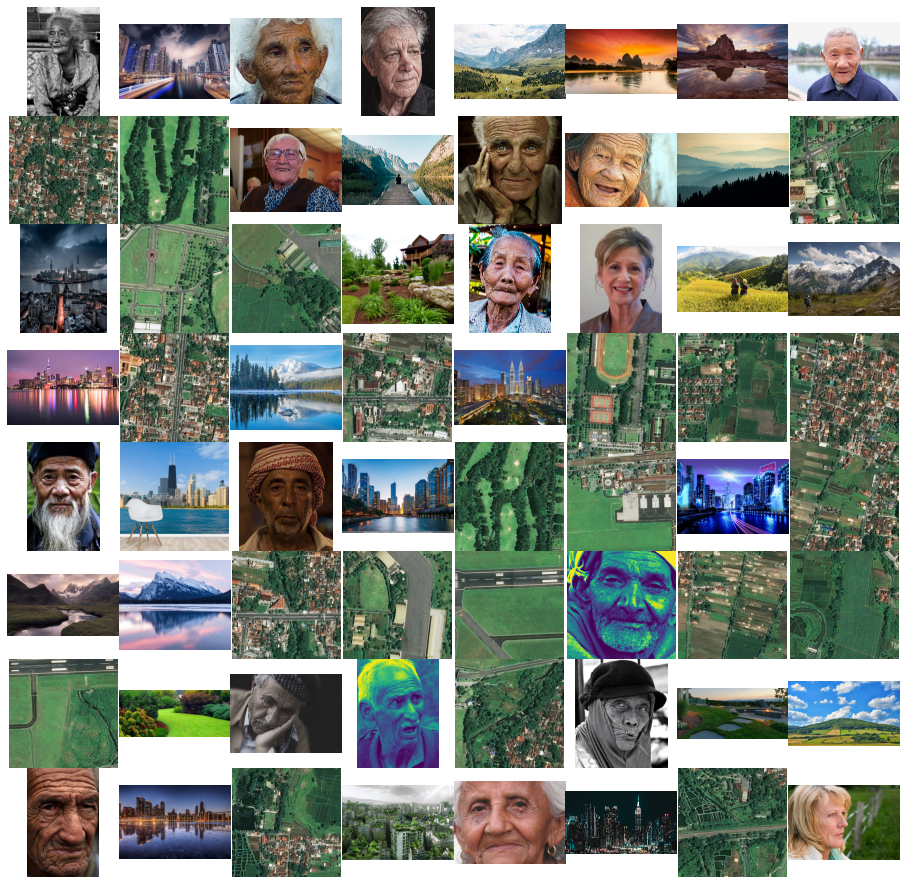

In [ ]:
# view images thumbnail (run it repeatly)
monty.draw.thumbnail_collage(wallaby.img_path)

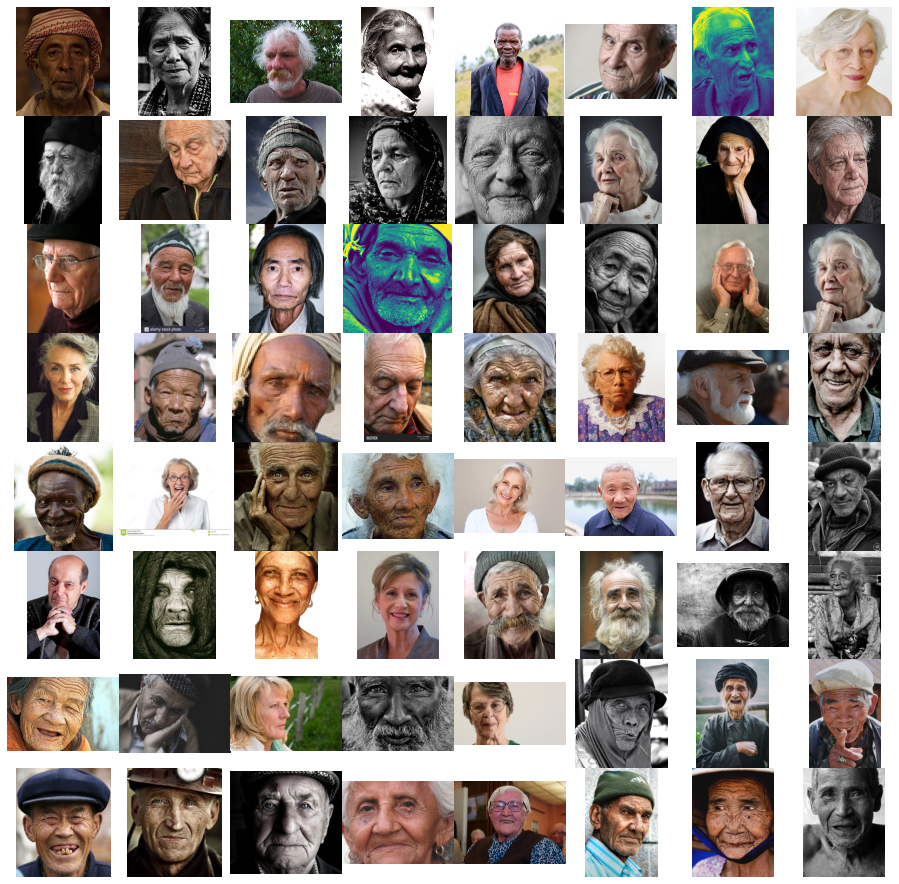

In [ ]:
# view just faces thumbnail (run it repeatly)
monty.bag.img_files = None # reset the thumbnail collection
monty.draw.thumbnail_collage(wallaby.img_path.joinpath("faces"))

- Wallaby wants to inspect one file at a time.

In [ ]:
# print inspect one image (randomly)
@add_method(AUD3)
def print_inspect_image(self):
  files = monty.fetch.file_name(self.img_path)
  max = len(files)
  idx = numpy.random.randint(0,max)
  monty.print.inspect_image(files[idx]) 
  monty.draw.images(files[idx])
  return

---------------------------------------- : ----------------------------------------
 Image size (row/h, col/width, [chanel]) : (550, 549, 3)
                              Image mode : RGB
                           Channel value : 3
                        (top left 8x8) R : Value below...
                                       + : [183 216 182  89  76  87  94  64]
                                       + : [169 216 178  87  85  90  85  66]
                                       + : [163 217 173  79  92  97  90  78]
                                       + : [165 210 166  72  87 102  94  72]
                                       + : [175 209 171  78  80 103 101  56]
                                       + : [177 214 181  83  73  95 100  57]
                                       + : [155 210 177  73  54  63  70  51]
                                       + : [130 206 176  66  44  32  33  37]
                        (top left 8x8) B : Value below...
                                   

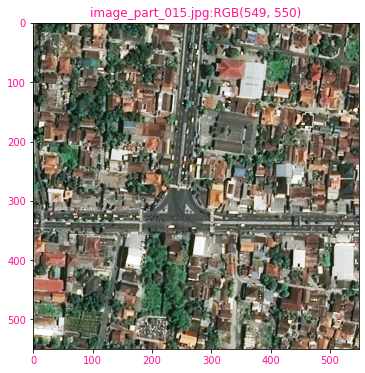

In [ ]:
# do it (run it repeatly)
wallaby.print_inspect_image()

-a 

## 2.6 | Clean The Images (Optional?)

- Data cleaning and data normalization may be optional in some cases. Still, Wallaby found that the ANN model will train faster with better accuracy when all images are the same size and square shape. It is because Wallaby will use the transfer-learning methodology for training the ANN model. The base ANN architecture is most likely be “resnet34, resnet50, uunet or resnet100,” and these ANN models were trained using square images.  

- Data cleaning does not affect the data augmentation outcome, but Wallaby is an organized nutcase. He likes things square and needly lineup. And since Monty knows how to do cleaning, it will not distract from the journey goals. 

- Once again, if you like to see an in-depth Jupyter Notebook about data cleaning (or cleansing), labeling, aggregating, identifying, and wrangling, contact Wallaby human companion.

- Wallaby starts with picking the image size. It is not as easy as it sounds because the photo’s size is tightly coupled with the goal of the ANN classification model and the subject matter. If the goal is simple as to classify handwriting digit, then 64x64 pixel is sufficient.

- What is the optimal photo size for ANN classification of the ethnicity of older adults faces? Clearly, the 2024x3040 pixel size is too big, and the 64x64 pixel size is too small. Should it be 400x400, 800x800 or 1024x1024 pixel size? Or does it even matter if Wallaby chooses any of the mid-range sizes? Is higher resolution always yield a better accuracy rate? There is no clear answer to any of the above questions. 

- There are practical considerations that need to take into account. The photo size 2024x3040 pixel yields 6,152,960 input nodes per image. When Wallaby multiplies the number of input nodes with the batch-size, the epoch count, and the number of layers in the ANN architecture, the result is a pretty large number. There is no GPU card with that big of RAM available on the open market. Eight, twelve, and sixteen Gigabytes of GPU RAM is the norm for ANN projects. 

- Wallaby hates to willy-nilly choose a size because he is trained as a canine computer scientist and not a psychologist. Maybe he should wait for his friend Magpiena to complete her master thesis. :-)

- For now, Wallaby chooses the size 448x448 pixel size because ResNet architecture uses the formular (2^n * 7) where “n” is an integer starting with one, i.e. (2^6 * 7) = 448. Wally wants all photo to be square and centered. 



In [ ]:
# Monty clean
wallaby.img_size = 448
monty.clean.square_images(wallaby.img_path, wallaby.img_size)

---------------------------------------- : ----------------------------------------
                               Directory : data/img
                       Result image size : 448x448
               Total squared image count : 300
---------------------------------------- : ----------------------------------------


True

- Wallaby is right. Monty cleans well. While at it, the file names are too long, and there is no embedded information in the file name, so Wallaby wants to make them all nice and tidy. :-)



In [ ]:
# Monty normalize file name
@add_method(AUD3)
def clean_normalize_filename(self):
  monty.clean.normalize_name(self.img_path.joinpath("faces"),head="face")
  monty.clean.normalize_name(self.img_path.joinpath("cityscape"),head="city")
  monty.clean.normalize_name(self.img_path.joinpath("landscape"),head="land")
  monty.clean.normalize_name(self.img_path.joinpath("satellite"),head="satellite")
  return

In [ ]:
# shorten and tidy file name
wallaby.clean_normalize_filename()

---------------------------------------- : ----------------------------------------
                 Total file rename count : 76
                           Original name : data/img/faces/c85634776ef9876cf3f7d00ff5da6a5c--beauty-portrait-portrait-photo.jpg
                                New name : data/img/faces/face-75.jpg
---------------------------------------- : ----------------------------------------
---------------------------------------- : ----------------------------------------
                 Total file rename count : 72
                           Original name : data/img/cityscape/ghyattsunset.jpg
                                New name : data/img/cityscape/city-71.jpg
---------------------------------------- : ----------------------------------------
---------------------------------------- : ----------------------------------------
                 Total file rename count : 74
                           Original name : data/img/landscape/Cathedral-Rocks-Sunrise-Kiama.

- Wallaby double-checks Monty's handy works.

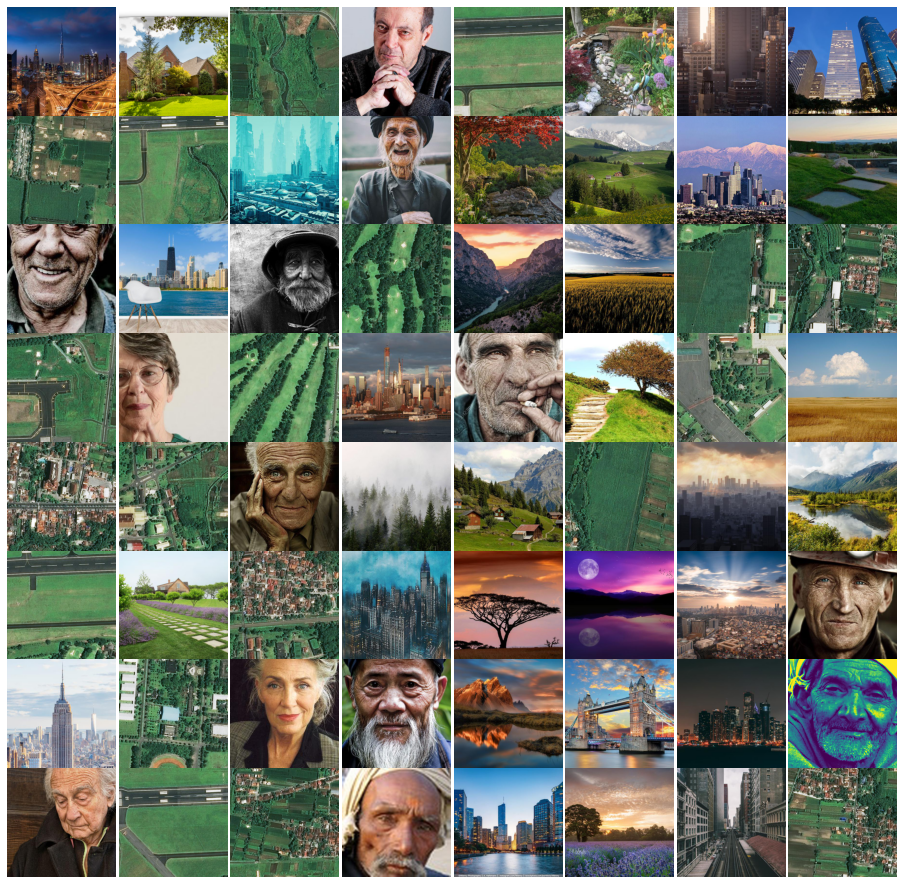

In [ ]:
# double check via thumbnail (run it repeatly)
monty.bag.img_files = None
monty.draw.thumbnail_collage(wallaby.img_path)

---------------------------------------- : ----------------------------------------
 Image size (row/h, col/width, [chanel]) : (448, 448, 3)
                              Image mode : RGB
                           Channel value : 3
                        (top left 8x8) R : Value below...
                                       + : [107  92  91 101  92  68  64  76]
                                       + : [99 85 82 92 87 70 72 86]
                                       + : [86 78 80 90 88 76 75 87]
                                       + : [77 76 83 95 94 79 72 76]
                                       + : [78 79 85 92 90 80 75 76]
                                       + : [82 81 79 79 77 78 83 88]
                                       + : [84 82 76 69 68 76 87 93]
                                       + : [83 84 79 71 70 76 83 85]
                        (top left 8x8) B : Value below...
                                       + : [155 140 139 147 138 114 107 119]
              

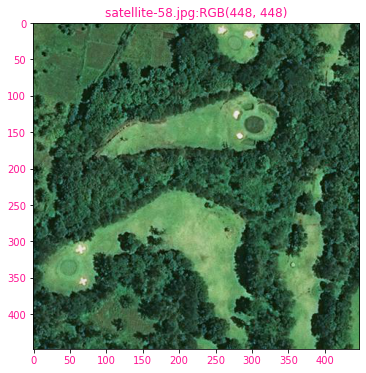

In [ ]:
# inspect one photo at a time (run it repeatly)
wallaby.print_inspect_image()

- That is nice. All images are squared, the same size, centered, and neatly named, e.g., “city1.jpg, city2.jpg, face1.jpg, face2.jpg, land1.jpg, land2.jpg”, and so on. Thank you, Monty.

- Wallaby ready to dive into the heart of the journey. He will turn the 300 images into thousands of photos without compromised the subject.

- The big bonus is the reduction in storage size. The four original zip files (unzip) total size is 412 MB, and after cleaning, the total size is 57 MB. It is a whopping 86% reduction in file storage.
 



## 2.7 | Flip | Augment Image Data

- Wallaby starts with flipping the photo left, right, and up and down. In other words, Wallaby will flip the image horizontally along the “Y-axis” and then flip the picture vertically along the “X-axis.”

- The goal is to see which image set, the “faces, cityscape, landscape or satellite,” can be flip horizontally, vertically, or both without compromised the subject. For example, a building can’t be flipped upside-down. 

- Wallaby may not need to write the code to illustrate flipping. However, the code is easy to write, and Wallaby can’t tell the difference between a building or a fire hydrant. After flipping images, there is a percentage of tilt, skew, warp, and light-contrast, which are harder to judge.



In [ ]:
import fastai
import fastai.vision
import os
import PIL
#
#
# fetch PIL image from fastai image (copy from Monty)
@add_method(AUD3)
def fetch_fastai_img_2_pil_img(self, src):
  v1 = src.data.cpu().permute(1, 2, 0).numpy()
  v2 = v1 * 255
  v3 = v2.astype(numpy.uint8)
  return PIL.Image.fromarray(v3)
#
#
# fetch the canvas (copy from Snoopy or Monty)
@add_method(AUD3)
def fetch_graph_canvas(self, row=1,col=1,size=(12,9)):
  return matplotlib.pyplot.subplots(row, col, figsize=size)
#
#
# fetch one transform img
@add_method(AUD3)
def _fetch_transform_img(self, name,tfms,tfms_index=0,**kwargs):
  img = fastai.vision.open_image(name)
  pil_img = self.fetch_fastai_img_2_pil_img(img.apply_tfms(tfms[tfms_index], **kwargs))
  return pil_img
#
#
# transfrom image (copy from Monty)
@add_method(AUD3)
def _draw_transform_img(self,name, tfms,rows=1, cols=6, width=18, height=6,tfms_index=0,**kwargs):
  # set up
  # tfms_index = 0 # zero = train, one = valid
  canvas, pic = self.fetch_graph_canvas(row=rows,col=cols,size=(width,height))
  #
  if (rows == 1):
    for i in range(cols):
      pil_img = self._fetch_transform_img(name,tfms)
      pic[i].imshow(pil_img)
  else:
    for j in range(rows):
      for i in range(cols):
        pil_img = self._fetch_transform_img(name,tfms)
        pic[j,i].imshow(pil_img)
  #
  # the "block=False" forces the next print statement to wait for the image to show
  # i.e. the images will not display last (it display in the intended sequence.)
  matplotlib.pyplot.show(block=False)
  canvas.show()
  return
#
#
# random select an image
@add_method(AUD3)
def fetch_random_img(self, src_path):
  try:
    a = self.img_list[0]
  except:
    self.img_list = list()
    for root, dirs, files in os.walk(src_path):
      for file in files:
        self.img_list.append(pathlib.Path(root, file))
  idx = numpy.random.randint(0,len(self.img_list))
  return self.img_list[idx]

In [ ]:
# flip image
@add_method(AUD3)
def draw_transform_flip(self,name, rows=1, cols=6, width=20, height=6,**kwargs):
  # set up
  t = fastai.vision.get_transforms(do_flip=True, flip_vert=False, p_affine=0,
    max_rotate=0,max_warp=0,max_zoom=0, max_lighting=0, p_lighting=0)
  # headers
  self._ph()
  self._pp("Transform Image", "Flip Horizontal Axis")
  self._pp("Probability for each image", "50% (Averaging 1 of 2 images)")
  self._pp("Augmentation images increase", "2 times (~e.g. was 100 now 200 images)")
  self._pp("Horizontal, \"do_flip\"", "True")
  self._pp("Hori. & Vert., \"flip_vert\"", "False")
  self._ph()
  #
  self._draw_transform_img(name,t,rows=rows,cols=cols,width=width,height=height, **kwargs)
  #
  # set up
  t = fastai.vision.get_transforms(do_flip=True, flip_vert=True, p_affine=0,
    max_rotate=0,max_warp=0,max_zoom=0, max_lighting=0, p_lighting=0)
  # headers
  self._ph()
  self._pp("Transform Image", "Flip Horizontal & Verticle Axis")
  self._pp("Probability for each image", "87.5% (Averaging 7 of 8 images)")
  self._pp("Augmentation images increase", "8 times (~e.g. was 100 now 800 images)")
  self._pp("Horizontal, \"do_flip\"", "True")
  self._pp("Hori. & Vert., \"flip_vert\"", "True")
  self._ph()
  #
  self._draw_transform_img(name,t,rows=rows,cols=cols,width=width,height=height, **kwargs)
  return
#

In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Flip Horizontal Axis
              Probability for each image : 50% (Averaging 1 of 2 images)
            Augmentation images increase : 2 times (~e.g. was 100 now 200 images)
                   Horizontal, "do_flip" : True
              Hori. & Vert., "flip_vert" : False
---------------------------------------- : ----------------------------------------


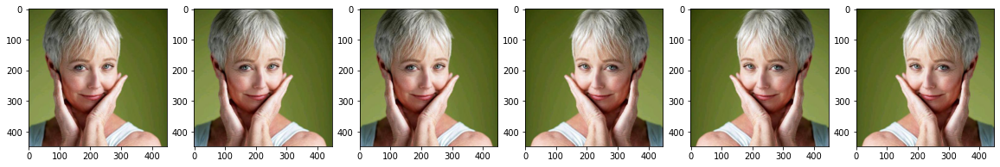

---------------------------------------- : ----------------------------------------
                         Transform Image : Flip Horizontal & Verticle Axis
              Probability for each image : 87.5% (Averaging 7 of 8 images)
            Augmentation images increase : 8 times (~e.g. was 100 now 800 images)
                   Horizontal, "do_flip" : True
              Hori. & Vert., "flip_vert" : True
---------------------------------------- : ----------------------------------------


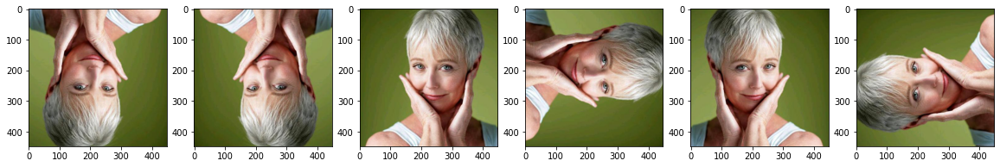

In [ ]:
# flip faces it (run it repeatly)
wallaby.draw_transform_flip(wallaby.fetch_random_img(wallaby.img_path.joinpath("faces")))

- Wallaby uses the “fast.ai” library for flipping, and the flip vertically is more like rotate 90 degrees. 

- After re-running the “flipping faces” a few times, it’s clear that people’s faces can be flip right-to-left without harm, but flipping vertically or rotating 90 degrees may be acceptable because kids can hang upside-down from a tree. 

- It depends on the ANN use-cases. For example, if the use-case allows kids to identify people’s ethnicity using their iPhone while walking in the park, kids will sometimes turn their phone sideways or upsidedown. Therefore, rotating the photo is a viable option.




In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Flip Horizontal Axis
              Probability for each image : 50% (Averaging 1 of 2 images)
            Augmentation images increase : 2 times (~e.g. was 100 now 200 images)
                   Horizontal, "do_flip" : True
              Hori. & Vert., "flip_vert" : False
---------------------------------------- : ----------------------------------------


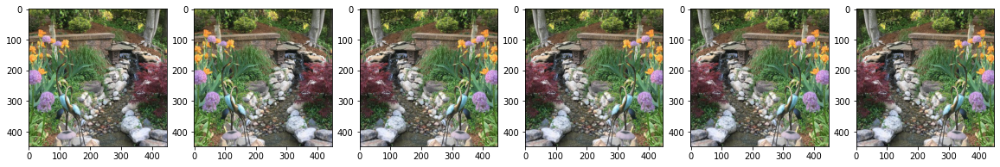

---------------------------------------- : ----------------------------------------
                         Transform Image : Flip Horizontal & Verticle Axis
              Probability for each image : 87.5% (Averaging 7 of 8 images)
            Augmentation images increase : 8 times (~e.g. was 100 now 800 images)
                   Horizontal, "do_flip" : True
              Hori. & Vert., "flip_vert" : True
---------------------------------------- : ----------------------------------------


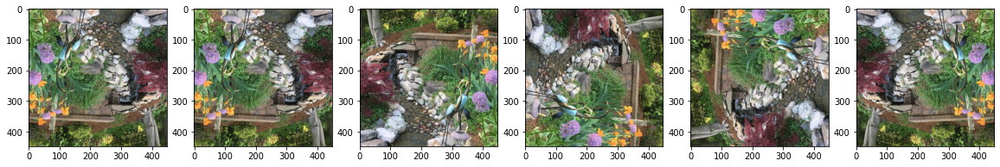

In [ ]:
# flip landscape it (run it repeatly)
wallaby.draw_transform_flip(wallaby.fetch_random_img(wallaby.img_path.joinpath("landscape")))

- For “landscape,” flipping horizontal is good, but flipping vertically or rotating 90 degrees doesn’t look right. If Wallaby is a World War II fighter pilot then seeing the landscape upsidedown or sideway is normal. 



In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Flip Horizontal Axis
              Probability for each image : 50% (Averaging 1 of 2 images)
            Augmentation images increase : 2 times (~e.g. was 100 now 200 images)
                   Horizontal, "do_flip" : True
              Hori. & Vert., "flip_vert" : False
---------------------------------------- : ----------------------------------------


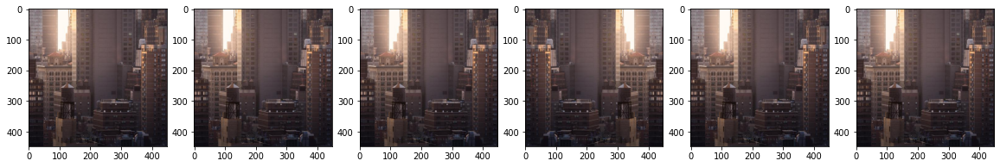

---------------------------------------- : ----------------------------------------
                         Transform Image : Flip Horizontal & Verticle Axis
              Probability for each image : 87.5% (Averaging 7 of 8 images)
            Augmentation images increase : 8 times (~e.g. was 100 now 800 images)
                   Horizontal, "do_flip" : True
              Hori. & Vert., "flip_vert" : True
---------------------------------------- : ----------------------------------------


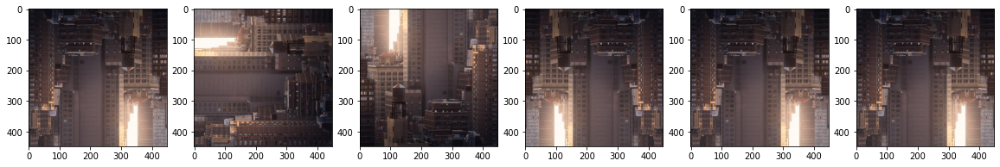

In [ ]:
# flip landscape it (run it repeatly)
wallaby.draw_transform_flip(wallaby.fetch_random_img(wallaby.img_path.joinpath("cityscape")))

- After repeatedly running the above “cityscape” code-cells, Wallaby found the same result as “landscape” images. Flipping image horizontally is OK, but not vertically. 


In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Flip Horizontal Axis
              Probability for each image : 50% (Averaging 1 of 2 images)
            Augmentation images increase : 2 times (~e.g. was 100 now 200 images)
                   Horizontal, "do_flip" : True
              Hori. & Vert., "flip_vert" : False
---------------------------------------- : ----------------------------------------


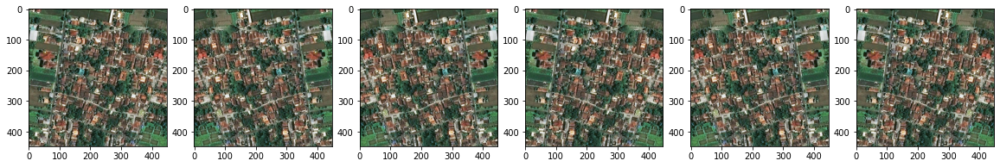

---------------------------------------- : ----------------------------------------
                         Transform Image : Flip Horizontal & Verticle Axis
              Probability for each image : 87.5% (Averaging 7 of 8 images)
            Augmentation images increase : 8 times (~e.g. was 100 now 800 images)
                   Horizontal, "do_flip" : True
              Hori. & Vert., "flip_vert" : True
---------------------------------------- : ----------------------------------------


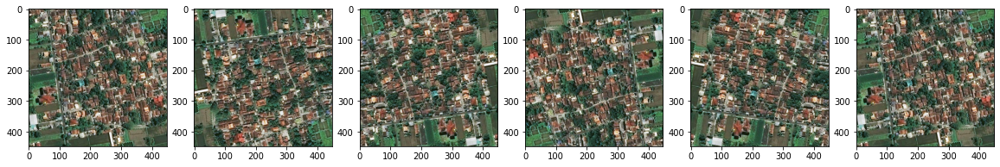

In [ ]:
# flip landscape it (run it repeatly)
wallaby.draw_transform_flip(wallaby.fetch_random_img(wallaby.img_path.joinpath("satellite")))

- Wallaby runs the above “satellite” code-cells over and over again, but he can’t tell right from wrong in the satellite photos. Therefore, both flipping right-and-left and up-and-down are valid options. His friend, Magpiena, is better at it because she can fly. 


## 2.8 | Warp | Augment Image Data

- To what degree of warping and how often are the two variables control the “warp” feature. The “degree” is a float number ranging from 0 to 1. Wallaby categories the “low warping” is between 0.0 and 0.15 degree, “mid warping” is between 0.0 and 0.40, and “high warping” is between 0.0 and 0.95.

- If you are hacking the notebook and Wallaby 100% encouraging it, change it repeatedly until you find the value best optimize for a particular image data set. 

- The “how often” variable is the probability when the system should use the “warp” feature. It is a float number ranging from 0 to 1 where zero doesn't use it, and one uses it all the time. For example, the probability of 0.75 means uses the “warp” feature three out of four-time. 


In [ ]:
# warp image
@add_method(AUD3)
def draw_transform_warp(self,name, rows=1, cols=6, width=20, height=6,**kwargs):
  # set up
  t = fastai.vision.get_transforms(do_flip=False, flip_vert=False, p_affine=0.85,
    max_rotate=0,max_warp=0.15,max_zoom=0, max_lighting=0, p_lighting=0)
  # headers
  self._ph()
  self._pp("Transform Image", "Warp (Low)")
  self._pp("Probability for each image", "75% (Averaging 3 of 4 images)")
  self._pp("Augmentation images increase", "At least 4 times (~e.g. was 100 now 400 images)")
  self._pp("Probability, \"p_affine\"", "0.75 (from 0 to 1, zero = not use)")
  self._pp("Warp, \"max_warp\"", "0.15 (between 0 and 0.15 scale for each image)")
  self._ph()
  #
  self._draw_transform_img(name,t,rows=rows,cols=cols,width=width,height=height, **kwargs)
  #
  # set up
  t = fastai.vision.get_transforms(do_flip=False, flip_vert=False, p_affine=0.85,
    max_rotate=0,max_warp=0.40,max_zoom=0, max_lighting=0, p_lighting=0)
  # headers
  self._ph()
  self._pp("Transform Image", "Warp (Medium)")
  self._pp("Warp, \"max_warp\"", "0.40 (between 0 to 0.40 scale for each image)")
  self._ph()
  #
  self._draw_transform_img(name,t,rows=rows,cols=cols,width=width,height=height, **kwargs)
  #
  # set up
  t = fastai.vision.get_transforms(do_flip=False, flip_vert=False, p_affine=0.75,
    max_rotate=0,max_warp=0.95,max_zoom=0, max_lighting=0, p_lighting=0)
  # headers
  self._ph()
  self._pp("Transform Image", "Warp (High)")
  self._pp("Warp, \"max_warp\"", "0.95 (between 0 to 0.95 degree for each image)")
  self._ph()
  #
  self._draw_transform_img(name,t,rows=rows,cols=cols,width=width,height=height, **kwargs)
  return
#

In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Warp (Low)
              Probability for each image : 75% (Averaging 3 of 4 images)
            Augmentation images increase : At least 4 times (~e.g. was 100 now 400 images)
                 Probability, "p_affine" : 0.75 (from 0 to 1, zero = not use)
                        Warp, "max_warp" : 0.15 (between 0 and 0.15 scale for each image)
---------------------------------------- : ----------------------------------------


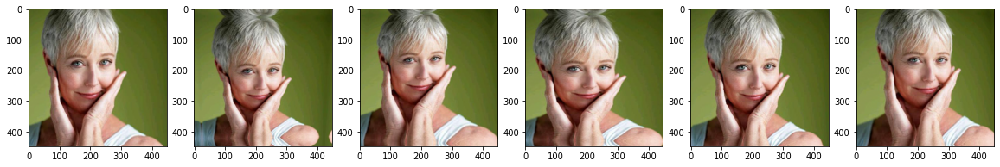

---------------------------------------- : ----------------------------------------
                         Transform Image : Warp (Medium)
                        Warp, "max_warp" : 0.40 (between 0 to 0.40 scale for each image)
---------------------------------------- : ----------------------------------------


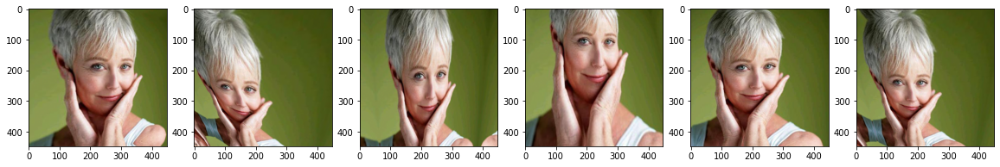

---------------------------------------- : ----------------------------------------
                         Transform Image : Warp (High)
                        Warp, "max_warp" : 0.95 (between 0 to 0.95 degree for each image)
---------------------------------------- : ----------------------------------------


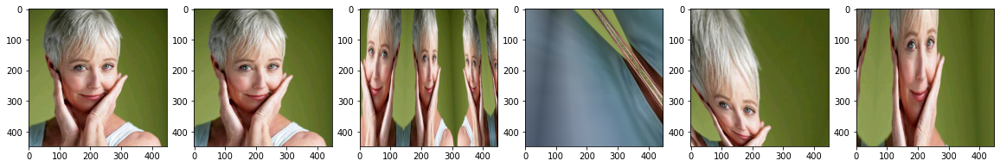

In [ ]:
# flip faces it (run it repeatly)
wallaby.draw_transform_warp(wallaby.fetch_random_img(wallaby.img_path.joinpath("faces")))

- Faces warping is subjective. Wallaby found that people are getting fatter or skinnier, and “low warping” seems to have that same effect. The person’s facial appearance does not change, and so Wallaby still recognizes the same face. 

- Once again, it depends on the ANN use-case. For example, if the use-case is to identify a person, then “low warping” is very useful. If that person gets fatter or skinnier, the system has no trouble recognizing him/her. It is the same for different camera angles that make a person’s face squashed or stretched. 

- “Mid or High” warping is too extreme for people’s faces. 


In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Warp (Low)
              Probability for each image : 75% (Averaging 3 of 4 images)
            Augmentation images increase : At least 4 times (~e.g. was 100 now 400 images)
                 Probability, "p_affine" : 0.75 (from 0 to 1, zero = not use)
                        Warp, "max_warp" : 0.15 (between 0 and 0.15 scale for each image)
---------------------------------------- : ----------------------------------------


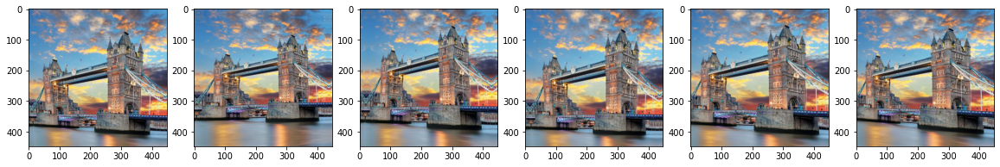

---------------------------------------- : ----------------------------------------
                         Transform Image : Warp (Medium)
                        Warp, "max_warp" : 0.40 (between 0 to 0.40 scale for each image)
---------------------------------------- : ----------------------------------------


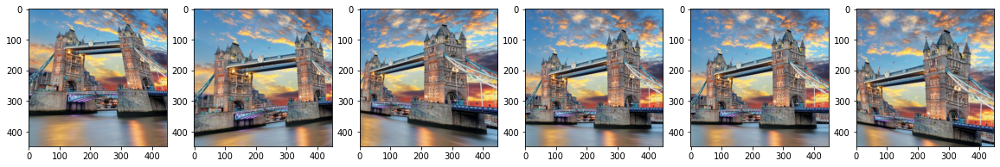

---------------------------------------- : ----------------------------------------
                         Transform Image : Warp (High)
                        Warp, "max_warp" : 0.95 (between 0 to 0.95 degree for each image)
---------------------------------------- : ----------------------------------------


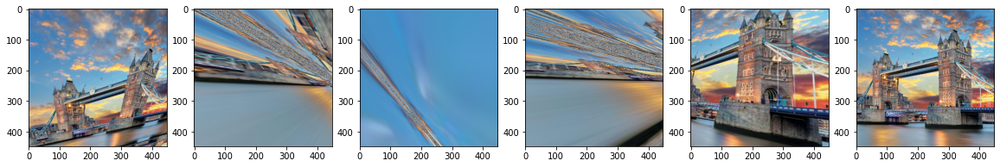

In [ ]:
# flip faces it (run it repeatly)
wallaby.draw_transform_warp(wallaby.fetch_random_img(wallaby.img_path.joinpath("cityscape")))

- Cityscape and warping features are not the right combination. Wallaby doesn’t want to see buildings leaning and swaying unless he is living in Pisa, Italy. 

- Wallaby couldn’t think of a good use-case where augmenting cityscape images with warping is warranted. Eating magic mushrooms causes Wallaby to see swaying buildings, but that is a different journey. :-)


In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Warp (Low)
              Probability for each image : 75% (Averaging 3 of 4 images)
            Augmentation images increase : At least 4 times (~e.g. was 100 now 400 images)
                 Probability, "p_affine" : 0.75 (from 0 to 1, zero = not use)
                        Warp, "max_warp" : 0.15 (between 0 and 0.15 scale for each image)
---------------------------------------- : ----------------------------------------


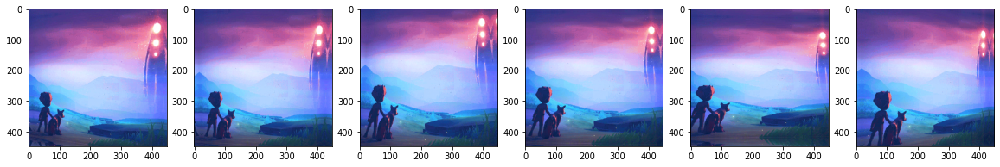

---------------------------------------- : ----------------------------------------
                         Transform Image : Warp (Medium)
                        Warp, "max_warp" : 0.40 (between 0 to 0.40 scale for each image)
---------------------------------------- : ----------------------------------------


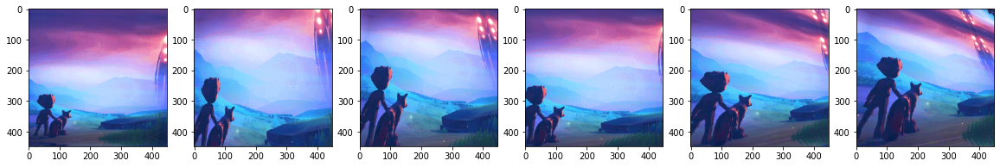

---------------------------------------- : ----------------------------------------
                         Transform Image : Warp (High)
                        Warp, "max_warp" : 0.95 (between 0 to 0.95 degree for each image)
---------------------------------------- : ----------------------------------------


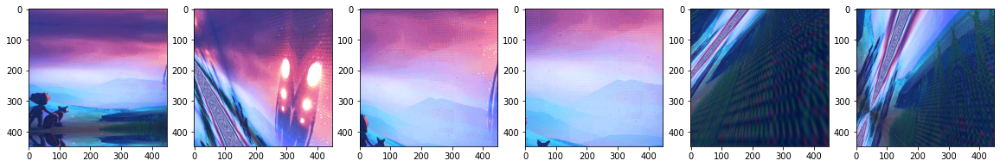

In [ ]:
# flip faces it (run it repeatly)
wallaby.draw_transform_warp(wallaby.fetch_random_img(wallaby.img_path.joinpath("landscape")))

- Nature doesn’t come in a straight line, so warping landscape photos are a viable option to increase the number of images for the ANN training session.

- The question is how high can Wallaby warps the photos before it affects the image integrity. After running the “landscape” code-cells repeatedly, Wallaby found that “Low” warping is sufficient, and “Mid” warping is sometimes OK. Therefore, Wallaby thinks the best value for distortion is 0.35. What is the optimal value that you find?



In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Warp (Low)
              Probability for each image : 75% (Averaging 3 of 4 images)
            Augmentation images increase : At least 4 times (~e.g. was 100 now 400 images)
                 Probability, "p_affine" : 0.75 (from 0 to 1, zero = not use)
                        Warp, "max_warp" : 0.15 (between 0 and 0.15 scale for each image)
---------------------------------------- : ----------------------------------------


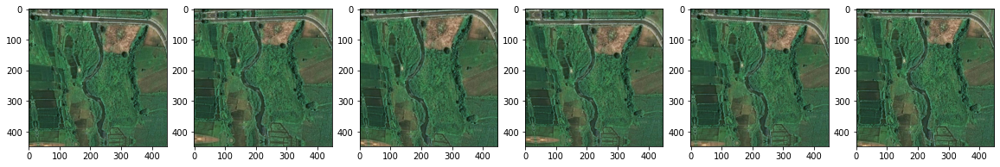

---------------------------------------- : ----------------------------------------
                         Transform Image : Warp (Medium)
                        Warp, "max_warp" : 0.40 (between 0 to 0.40 scale for each image)
---------------------------------------- : ----------------------------------------


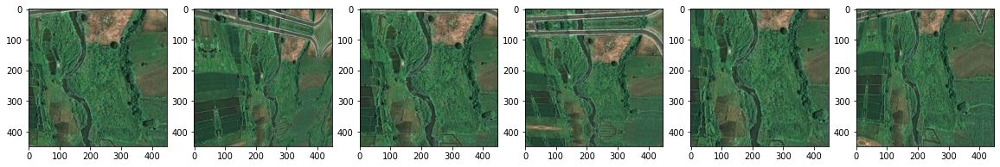

---------------------------------------- : ----------------------------------------
                         Transform Image : Warp (High)
                        Warp, "max_warp" : 0.95 (between 0 to 0.95 degree for each image)
---------------------------------------- : ----------------------------------------


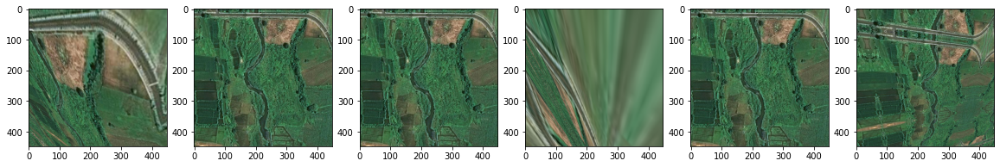

In [ ]:
# flip faces it (run it repeatly)
wallaby.draw_transform_warp(wallaby.fetch_random_img(wallaby.img_path.joinpath("satellite")))

- Satellite or aerial photos are a mixture of landscape and cityscape, where people like to build in a straight line, and nature like anything goes. 

- It is a clear case where the ANN project’s use-case or goal dictates to use or not to use the warp feature. For example, suppose the goal is to identify roads, buildings, streets, rivers, forests, and mountains. In that case, warping is a viable option, but if the goal is to identify the city from the aerial photos, then warping is not a good option. It is because bending and straightening of the streets are the characteristics of a particular city. 


## 2.9 | Tilt | Augment Image Data

- Another fun augmentation feature is tilting the photo left or right. The tilting degree range is typically between -45 degrees and 45 degrees, but Wallaby can spin it around from zero to 360 degrees. 


- The “how often” variable is the probability when the system should use the “tilt” feature. It is a float number ranging from 0 to 1 where zero doesn’t use it, and one uses it all the time. For example, the probability of 0.75 means uses the “tilt” feature three out of four-time.


In [ ]:
# draw tilt
@add_method(AUD3)
# -------------------------------------- + ----------------------------------------
def draw_transform_tilt(self,name, rows=1, cols=6, width=20, height=6,**kwargs):
  # set up
  t = fastai.vision.get_transforms(do_flip=False, flip_vert=False, p_affine=0.75,
    max_rotate=10,max_warp=0,max_zoom=0, max_lighting=0, p_lighting=0)
  # headers
  self._ph()
  self._pp("Transform Image", "Tilt or Rotate (Low)")
  self._pp("Probability for each image", "75% (Averaging 3 of 4 images)")
  self._pp("Augmentation images increase", "At least 4 times (~e.g. was 100 now 400 images)")
  self._pp("Probability, \"p_affine\"", "0.75 (from 0 to 1, zero = not use)")
  self._pp("Rotate, \"max_rotate\"", "10 (between -10 to 10 degree for each image)")
  self._ph()
  #
  self._draw_transform_img(name,t,rows=rows,cols=cols,width=width,height=height, **kwargs)
  #
  # set up
  t = fastai.vision.get_transforms(do_flip=False, flip_vert=False, p_affine=0.75,
    max_rotate=45,max_warp=0,max_zoom=0, max_lighting=0, p_lighting=0)
  # headers
  self._ph()
  self._pp("Transform Image", "Tilt or Rotate (Medium)")
  self._pp("Rotate, \"max_rotate\"", "45 (between -45 to 45 degree for each image)")
  self._ph()
  #
  self._draw_transform_img(name,t,rows=rows,cols=cols,width=width,height=height, **kwargs)
  #
  # set up
  t = fastai.vision.get_transforms(do_flip=False, flip_vert=False, p_affine=0.75,
    max_rotate=135,max_warp=0,max_zoom=0, max_lighting=0, p_lighting=0)
  # headers
  self._ph()
  self._pp("Transform Image", "Tilt or Rotate(High)")
  self._pp("Rotate, \"max_rotate\"", "135 (between -135 to 135 degree for each image)")
  self._ph()
  #
  self._draw_transform_img(name,t,rows=rows,cols=cols,width=width,height=height, **kwargs)
  return
#

In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Tilt or Rotate (Low)
              Probability for each image : 75% (Averaging 3 of 4 images)
            Augmentation images increase : At least 4 times (~e.g. was 100 now 400 images)
                 Probability, "p_affine" : 0.75 (from 0 to 1, zero = not use)
                    Rotate, "max_rotate" : 10 (between -10 to 10 degree for each image)
---------------------------------------- : ----------------------------------------


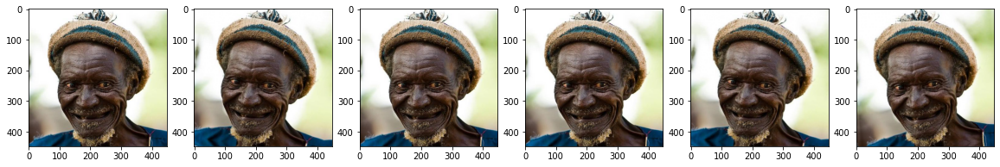

---------------------------------------- : ----------------------------------------
                         Transform Image : Tilt or Rotate (Medium)
                    Rotate, "max_rotate" : 45 (between -45 to 45 degree for each image)
---------------------------------------- : ----------------------------------------


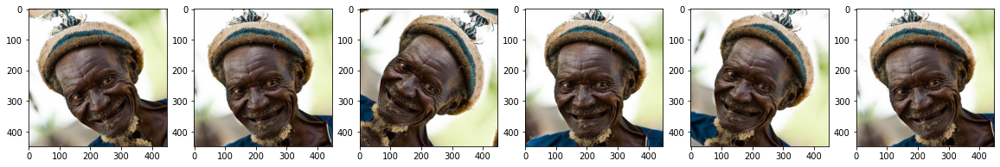

---------------------------------------- : ----------------------------------------
                         Transform Image : Tilt or Rotate(High)
                    Rotate, "max_rotate" : 135 (between -135 to 135 degree for each image)
---------------------------------------- : ----------------------------------------


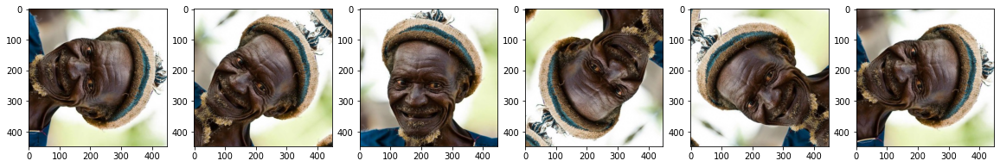

In [ ]:
# flip faces it (run it repeatly)
wallaby.draw_transform_tilt(wallaby.fetch_random_img(wallaby.img_path.joinpath("faces")))

- For face photos, “Low and Mid” tilting is natural because people are tilting their heads. 

In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Tilt or Rotate (Low)
              Probability for each image : 75% (Averaging 3 of 4 images)
            Augmentation images increase : At least 4 times (~e.g. was 100 now 400 images)
                 Probability, "p_affine" : 0.75 (from 0 to 1, zero = not use)
                    Rotate, "max_rotate" : 10 (between -10 to 10 degree for each image)
---------------------------------------- : ----------------------------------------


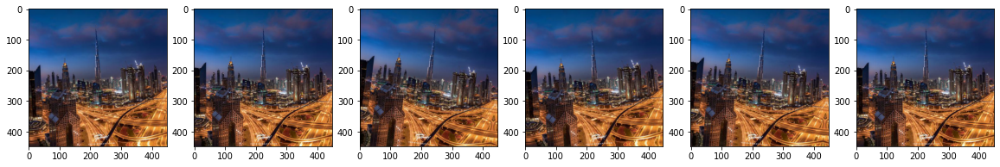

---------------------------------------- : ----------------------------------------
                         Transform Image : Tilt or Rotate (Medium)
                    Rotate, "max_rotate" : 45 (between -45 to 45 degree for each image)
---------------------------------------- : ----------------------------------------


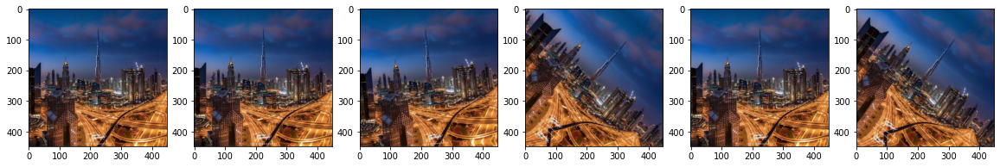

---------------------------------------- : ----------------------------------------
                         Transform Image : Tilt or Rotate(High)
                    Rotate, "max_rotate" : 135 (between -135 to 135 degree for each image)
---------------------------------------- : ----------------------------------------


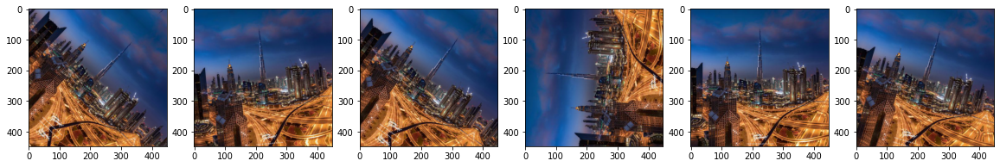

In [ ]:
# flip faces it (run it repeatly)
wallaby.draw_transform_tilt(wallaby.fetch_random_img(wallaby.img_path.joinpath("cityscape")))

- For cityscape photos, tilting is depending on the use case. For example, if the use case involves people biking around a city taking photos, then “Low to Mid” tilting is a good option. If the use case is taking pictures from a fixed camera mounted on a car, tilting may not be viable.

In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Tilt or Rotate (Low)
              Probability for each image : 75% (Averaging 3 of 4 images)
            Augmentation images increase : At least 4 times (~e.g. was 100 now 400 images)
                 Probability, "p_affine" : 0.75 (from 0 to 1, zero = not use)
                    Rotate, "max_rotate" : 10 (between -10 to 10 degree for each image)
---------------------------------------- : ----------------------------------------


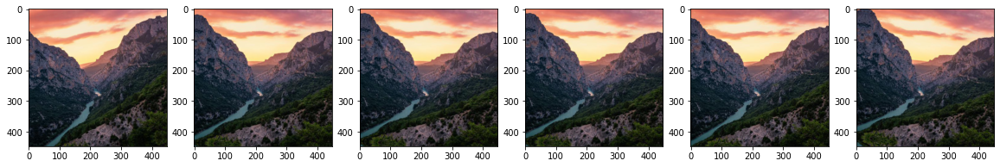

---------------------------------------- : ----------------------------------------
                         Transform Image : Tilt or Rotate (Medium)
                    Rotate, "max_rotate" : 45 (between -45 to 45 degree for each image)
---------------------------------------- : ----------------------------------------


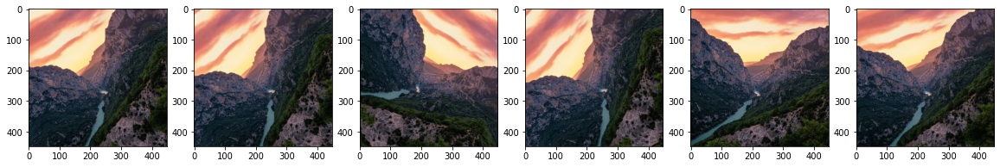

---------------------------------------- : ----------------------------------------
                         Transform Image : Tilt or Rotate(High)
                    Rotate, "max_rotate" : 135 (between -135 to 135 degree for each image)
---------------------------------------- : ----------------------------------------


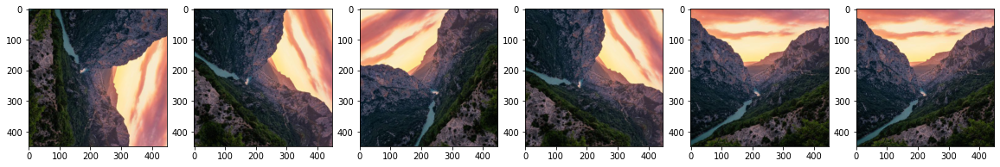

In [ ]:
# flip faces it (run it repeatly)
wallaby.draw_transform_tilt(wallaby.fetch_random_img(wallaby.img_path.joinpath("landscape")))

- For landscape photos, nature is curvy, and so “Low to Mid” tilting looks natural. 

In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Tilt or Rotate (Low)
              Probability for each image : 75% (Averaging 3 of 4 images)
            Augmentation images increase : At least 4 times (~e.g. was 100 now 400 images)
                 Probability, "p_affine" : 0.75 (from 0 to 1, zero = not use)
                    Rotate, "max_rotate" : 10 (between -10 to 10 degree for each image)
---------------------------------------- : ----------------------------------------


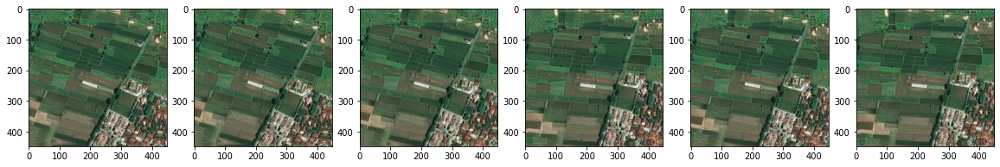

---------------------------------------- : ----------------------------------------
                         Transform Image : Tilt or Rotate (Medium)
                    Rotate, "max_rotate" : 45 (between -45 to 45 degree for each image)
---------------------------------------- : ----------------------------------------


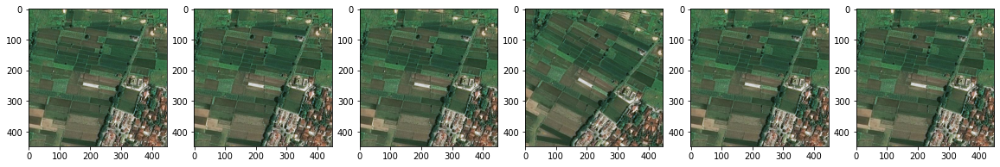

---------------------------------------- : ----------------------------------------
                         Transform Image : Tilt or Rotate(High)
                    Rotate, "max_rotate" : 135 (between -135 to 135 degree for each image)
---------------------------------------- : ----------------------------------------


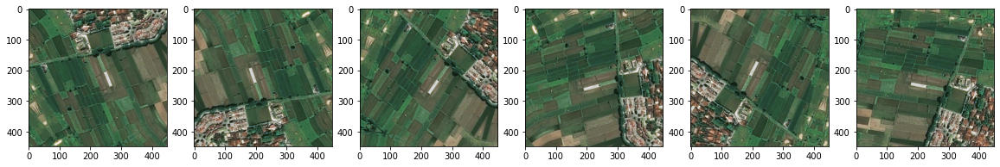

In [ ]:
# flip faces it (run it repeatly)
wallaby.draw_transform_tilt(wallaby.fetch_random_img(wallaby.img_path.joinpath("satellite")))

- For satellite photos, Wallaby’s friend Magpiena sometimes flies the old “CAC Boomerang” aircraft, and her photos are anything but straight. Therefore, tilting is a good image augmentation option for satellite photos.  

## 2.10 | Zoom | Augment Image Data

- For image augmentation, the zoom feature is more effective when the pictures are squared and centered. The typical range is a float number between 1.0 and 2.0, where 2.0 means double the image size. It is hard to imagine what use-cases would require Wallaby to increase the image size by a factor of three, four, or five.  

In [ ]:
#
@add_method(AUD3)
def draw_transform_zoom(self,name, rows=1, cols=6, width=20, height=6,**kwargs):
  # set up
  t = fastai.vision.get_transforms(do_flip=False, flip_vert=False, p_affine=0.75,
    max_rotate=0,max_warp=0,max_zoom=1.2, max_lighting=0, p_lighting=0)
  # headers
  self._ph()
  self._pp("Transform Image", "Zoom (Low)")
  self._pp("Probability for each image", "75% (Averaging 3 of 4 images)")
  self._pp("Augmentation images increase", "At least 4 times (~e.g. was 100 now 400 images)")
  self._pp("Probability, \"p_affine\"", "0.75 (from 1.0 to 2.0, zero = not use)")
  self._pp("Zoom, \"max_zoom\"", "1.2 (between 1 and 1.2 zoom size for each image)")
  self._ph()
  #
  self._draw_transform_img(name,t,rows=rows,cols=cols,width=width,height=height, **kwargs)
  #
  # set up
  t = fastai.vision.get_transforms(do_flip=False, flip_vert=False, p_affine=0.75,
    max_rotate=0,max_warp=0,max_zoom=1.4, max_lighting=0, p_lighting=0)
  # headers
  self._ph()
  self._pp("Transform Image", "Zoom (Medium)")
  self._pp("Zoom, \"max_zoom\"", "1.40 (between 1 to 1.40 zoom for each image)")
  self._ph()
  #
  self._draw_transform_img(name,t,rows=rows,cols=cols,width=width,height=height, **kwargs)
  #
  # set up
  t = fastai.vision.get_transforms(do_flip=False, flip_vert=False, p_affine=0.75,
    max_rotate=0,max_warp=0,max_zoom=1.9, max_lighting=0, p_lighting=0)
  # headers
  self._ph()
  self._pp("Transform Image", "Zoom (High)")
  self._pp("Zoom, \"max_zoom\"", "0.95 (between 1 to 1.95 zoom for each image)")
  self._ph()
  #
  self._draw_transform_img(name,t,rows=rows,cols=cols,width=width,height=height, **kwargs)
  return
#

In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Zoom (Low)
              Probability for each image : 75% (Averaging 3 of 4 images)
            Augmentation images increase : At least 4 times (~e.g. was 100 now 400 images)
                 Probability, "p_affine" : 0.75 (from 1.0 to 2.0, zero = not use)
                        Zoom, "max_zoom" : 1.2 (between 1 and 1.2 zoom size for each image)
---------------------------------------- : ----------------------------------------


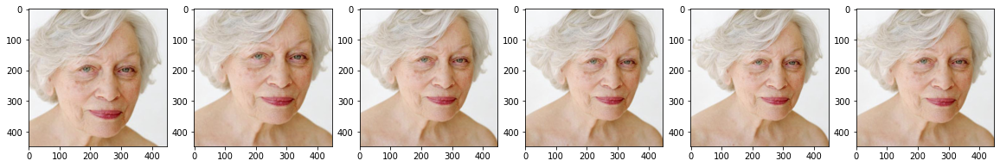

---------------------------------------- : ----------------------------------------
                         Transform Image : Zoom (Medium)
                        Zoom, "max_zoom" : 1.40 (between 1 to 1.40 zoom for each image)
---------------------------------------- : ----------------------------------------


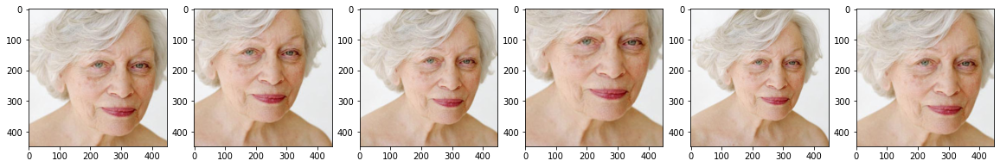

---------------------------------------- : ----------------------------------------
                         Transform Image : Zoom (High)
                        Zoom, "max_zoom" : 0.95 (between 1 to 1.95 zoom for each image)
---------------------------------------- : ----------------------------------------


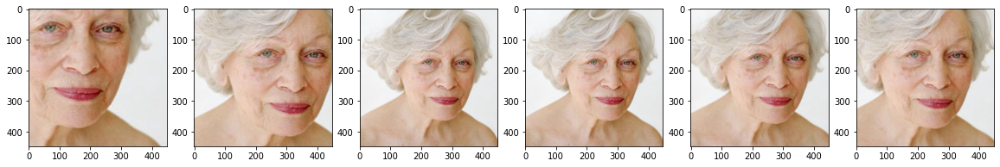

In [ ]:
# flip faces it (run it repeatly)
wallaby.draw_transform_zoom(wallaby.fetch_random_img(wallaby.img_path.joinpath("faces")))

- Since the face photos are portrait, squared, and centered, “Low or Mid” zoom is acceptable. 

In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Zoom (Low)
              Probability for each image : 75% (Averaging 3 of 4 images)
            Augmentation images increase : At least 4 times (~e.g. was 100 now 400 images)
                 Probability, "p_affine" : 0.75 (from 1.0 to 2.0, zero = not use)
                        Zoom, "max_zoom" : 1.2 (between 1 and 1.2 zoom size for each image)
---------------------------------------- : ----------------------------------------


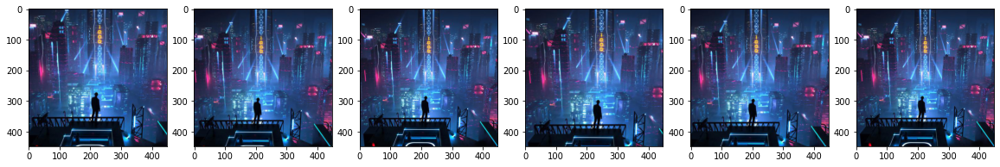

---------------------------------------- : ----------------------------------------
                         Transform Image : Zoom (Medium)
                        Zoom, "max_zoom" : 1.40 (between 1 to 1.40 zoom for each image)
---------------------------------------- : ----------------------------------------


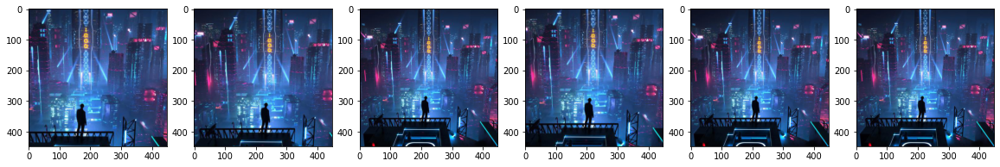

---------------------------------------- : ----------------------------------------
                         Transform Image : Zoom (High)
                        Zoom, "max_zoom" : 0.95 (between 1 to 1.95 zoom for each image)
---------------------------------------- : ----------------------------------------


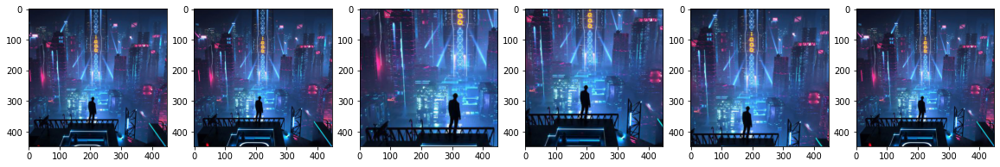

In [ ]:
# flip faces it (run it repeatly)
wallaby.draw_transform_zoom(wallaby.fetch_random_img(wallaby.img_path.joinpath("cityscape")))

- In cityscape photos, “Low” zoom is reasonable. The degree of zooming is dictating by the use-case.

In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Zoom (Low)
              Probability for each image : 75% (Averaging 3 of 4 images)
            Augmentation images increase : At least 4 times (~e.g. was 100 now 400 images)
                 Probability, "p_affine" : 0.75 (from 1.0 to 2.0, zero = not use)
                        Zoom, "max_zoom" : 1.2 (between 1 and 1.2 zoom size for each image)
---------------------------------------- : ----------------------------------------


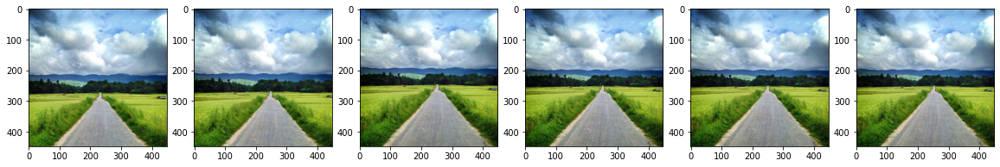

---------------------------------------- : ----------------------------------------
                         Transform Image : Zoom (Medium)
                        Zoom, "max_zoom" : 1.40 (between 1 to 1.40 zoom for each image)
---------------------------------------- : ----------------------------------------


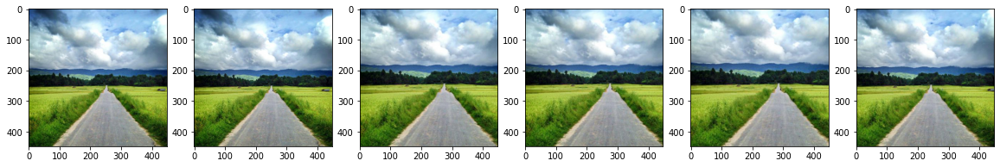

---------------------------------------- : ----------------------------------------
                         Transform Image : Zoom (High)
                        Zoom, "max_zoom" : 0.95 (between 1 to 1.95 zoom for each image)
---------------------------------------- : ----------------------------------------


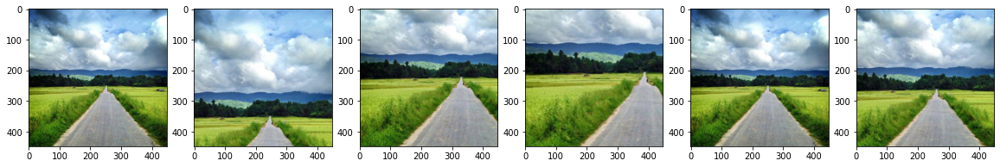

In [ ]:
# flip faces it (run it repeatly)
wallaby.draw_transform_zoom(wallaby.fetch_random_img(wallaby.img_path.joinpath("landscape")))

- In landscape photos, the zoom feature and the factor of zoom level are depending on the use-case. The images are of a wide-shot; therefore, zooming up to the “Mid” level is acceptable. 

In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Zoom (Low)
              Probability for each image : 75% (Averaging 3 of 4 images)
            Augmentation images increase : At least 4 times (~e.g. was 100 now 400 images)
                 Probability, "p_affine" : 0.75 (from 1.0 to 2.0, zero = not use)
                        Zoom, "max_zoom" : 1.2 (between 1 and 1.2 zoom size for each image)
---------------------------------------- : ----------------------------------------


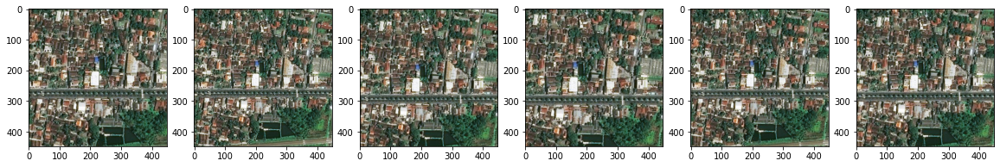

---------------------------------------- : ----------------------------------------
                         Transform Image : Zoom (Medium)
                        Zoom, "max_zoom" : 1.40 (between 1 to 1.40 zoom for each image)
---------------------------------------- : ----------------------------------------


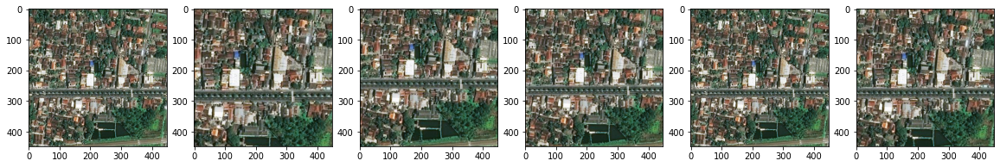

---------------------------------------- : ----------------------------------------
                         Transform Image : Zoom (High)
                        Zoom, "max_zoom" : 0.95 (between 1 to 1.95 zoom for each image)
---------------------------------------- : ----------------------------------------


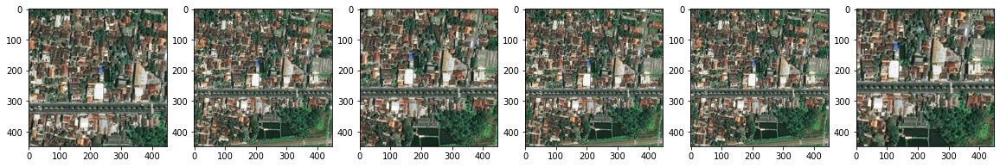

In [ ]:
# flip faces it (run it repeatly)
wallaby.draw_transform_zoom(wallaby.fetch_random_img(wallaby.img_path.joinpath("satellite")))

- In satellite photos, a typical use-case is to classify multi-labels such as buildings, rivers, bridges, churches, roads, forests, meadows, cornfields, and so on. If Wallaby uses the zoom feature, he might miss the building on edge and would not label the image correctly.

## 2.11 | Light | Augment Image Data

- There are many more image augmentation methods, but Wallaby will try the “light-effect” as the last one. The “light” factor is a float number between 0 and 1.0, where a higher number implies more effects. 

- The “how often” variable is the probability when the system should use the “light-effect” feature. It is a float number ranging from 0 to 1 where zero doesn’t use it, and one uses it all the time. For example, the probability of 0.75 means uses the “light-effect” feature three out of four-time.


In [ ]:
# light
@add_method(AUD3)
def draw_transform_light(self,name, rows=1, cols=6, width=20, height=6,**kwargs):
  # set up
  t = fastai.vision.get_transforms(do_flip=False, flip_vert=False, p_affine=0,
    max_rotate=0,max_warp=0,max_zoom=0, max_lighting=0.2, p_lighting=0.75)
  # headers
  self._ph()
  self._pp("Transform Image", "Light (Low)")
  self._pp("Probability for each image", "75% (Averaging 3 of 4 images)")
  self._pp("Augmentation images increase", "At least 4 times (~e.g. was 100 now 400 images)")
  self._pp("Probability, \"p_lighting\"", "0.75 (from 1.0 to 2.0, zero = not use)")
  self._pp("Light, \"max_lighting\"", "0.2 (between 0 and 0.2 light exposure for each image)")
  self._ph()
  #
  self._draw_transform_img(name,t,rows=rows,cols=cols,width=width,height=height, **kwargs)
  #
  # set up
  t = fastai.vision.get_transforms(do_flip=False, flip_vert=False, p_affine=0,
    max_rotate=0,max_warp=0,max_zoom=0, max_lighting=0.4, p_lighting=0.75)
  # headers
  self._ph()
  self._pp("Transform Image", "Light (Medium)")
  self._pp("Light, \"max_lighting\"", "0.4 (between 0 and 0.4 light exposure for each image)")
  self._ph()
  #
  self._draw_transform_img(name,t,rows=rows,cols=cols,width=width,height=height, **kwargs)
  #
  # set up
  t = fastai.vision.get_transforms(do_flip=False, flip_vert=False, p_affine=0,
    max_rotate=0,max_warp=0,max_zoom=0, max_lighting=0.95, p_lighting=0.75)
  # headers
  self._ph()
  self._pp("Transform Image", "Light (High)")
  self._pp("Light, \"max_lighting\"", "0.95 (between 0 and 0.95 light exposure for each image)")
  self._ph()
  #
  self._draw_transform_img(name,t,rows=rows,cols=cols,width=width,height=height, **kwargs)
  return

In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Light (Low)
              Probability for each image : 75% (Averaging 3 of 4 images)
            Augmentation images increase : At least 4 times (~e.g. was 100 now 400 images)
               Probability, "p_lighting" : 0.75 (from 1.0 to 2.0, zero = not use)
                   Light, "max_lighting" : 0.2 (between 0 and 0.2 light exposure for each image)
---------------------------------------- : ----------------------------------------


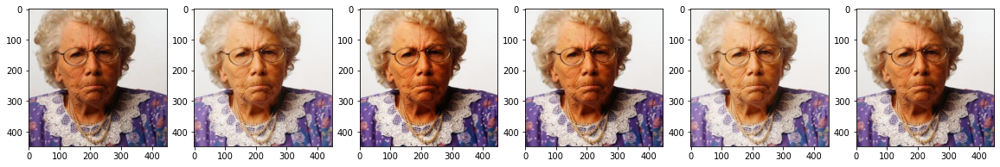

---------------------------------------- : ----------------------------------------
                         Transform Image : Light (Medium)
                   Light, "max_lighting" : 0.4 (between 0 and 0.4 light exposure for each image)
---------------------------------------- : ----------------------------------------


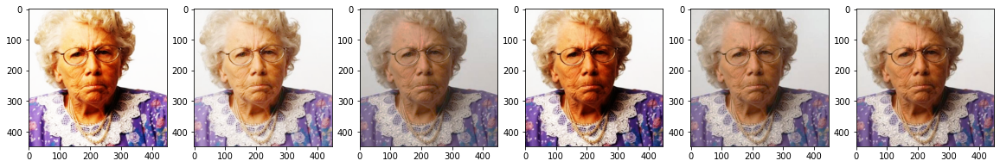

---------------------------------------- : ----------------------------------------
                         Transform Image : Light (High)
                   Light, "max_lighting" : 0.95 (between 0 and 0.95 light exposure for each image)
---------------------------------------- : ----------------------------------------


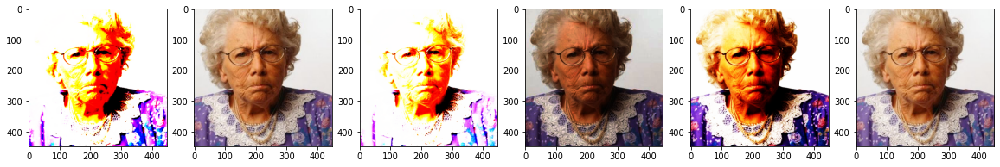

In [ ]:
# flip faces it (run it repeatly)
wallaby.draw_transform_light(wallaby.fetch_random_img(wallaby.img_path.joinpath("faces")))

- For people’s face photos, the light-effect changes their skin color from a lighter tone to a darker tone or vice-versa. Wallaby found that the “Low” light-effect might be acceptable because people are tanner in the Summer and whiter in the Winter. 

- Once again, the use-cases prescribe whether to use or not to use the light-effect filter. For example, if the use-case is for classifying a person’s identity, then light-effect is meaningful. If the use-case is for classifying a person’s ethnicity, then light-effect is not a good option.


In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Light (Low)
              Probability for each image : 75% (Averaging 3 of 4 images)
            Augmentation images increase : At least 4 times (~e.g. was 100 now 400 images)
               Probability, "p_lighting" : 0.75 (from 1.0 to 2.0, zero = not use)
                   Light, "max_lighting" : 0.2 (between 0 and 0.2 light exposure for each image)
---------------------------------------- : ----------------------------------------


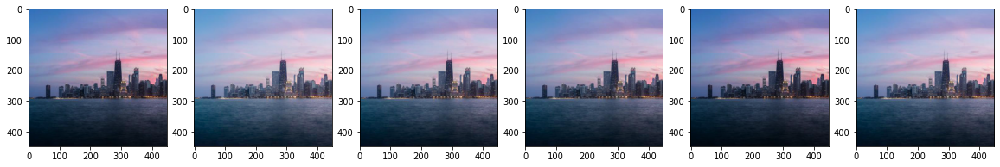

---------------------------------------- : ----------------------------------------
                         Transform Image : Light (Medium)
                   Light, "max_lighting" : 0.4 (between 0 and 0.4 light exposure for each image)
---------------------------------------- : ----------------------------------------


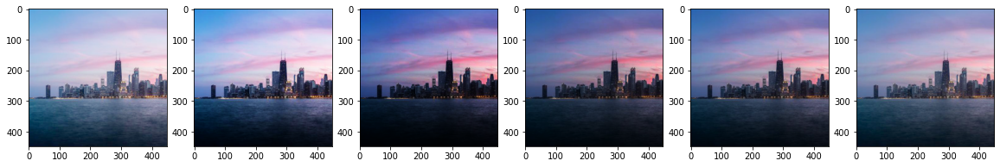

---------------------------------------- : ----------------------------------------
                         Transform Image : Light (High)
                   Light, "max_lighting" : 0.95 (between 0 and 0.95 light exposure for each image)
---------------------------------------- : ----------------------------------------


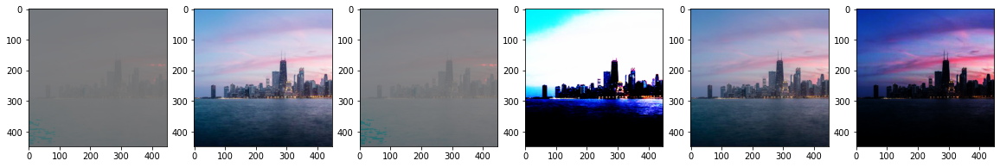

In [ ]:
# flip faces it (run it repeatly)
wallaby.draw_transform_light(wallaby.fetch_random_img(wallaby.img_path.joinpath("cityscape")))

- For cityscape photos, the light source is the sunlight; therefore, light-effect is a valid option to extend the image set through augmentation. Wallaby recommends the “Low and Mid” light-effect option.

In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Light (Low)
              Probability for each image : 75% (Averaging 3 of 4 images)
            Augmentation images increase : At least 4 times (~e.g. was 100 now 400 images)
               Probability, "p_lighting" : 0.75 (from 1.0 to 2.0, zero = not use)
                   Light, "max_lighting" : 0.2 (between 0 and 0.2 light exposure for each image)
---------------------------------------- : ----------------------------------------


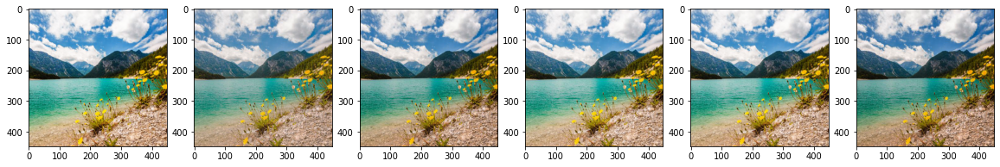

---------------------------------------- : ----------------------------------------
                         Transform Image : Light (Medium)
                   Light, "max_lighting" : 0.4 (between 0 and 0.4 light exposure for each image)
---------------------------------------- : ----------------------------------------


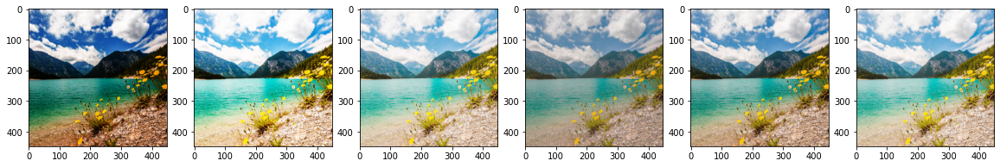

---------------------------------------- : ----------------------------------------
                         Transform Image : Light (High)
                   Light, "max_lighting" : 0.95 (between 0 and 0.95 light exposure for each image)
---------------------------------------- : ----------------------------------------


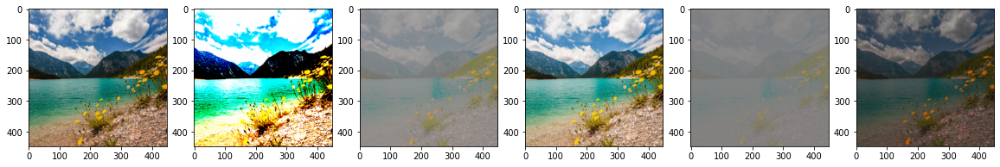

In [ ]:
# flip faces it (run it repeatly)
wallaby.draw_transform_light(wallaby.fetch_random_img(wallaby.img_path.joinpath("landscape")))

- The landscape photos are the same as the cityscape photos when it comes to light-effect. They are both lit by sunlight, so the “Low and Mid” light-effect level is sufficient. 

In [ ]:
# reset the internal list
wallaby.img_list = None 

---------------------------------------- : ----------------------------------------
                         Transform Image : Light (Low)
              Probability for each image : 75% (Averaging 3 of 4 images)
            Augmentation images increase : At least 4 times (~e.g. was 100 now 400 images)
               Probability, "p_lighting" : 0.75 (from 1.0 to 2.0, zero = not use)
                   Light, "max_lighting" : 0.2 (between 0 and 0.2 light exposure for each image)
---------------------------------------- : ----------------------------------------


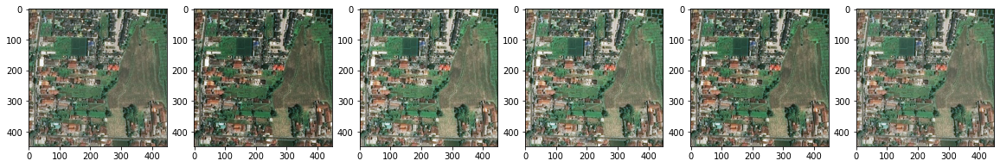

---------------------------------------- : ----------------------------------------
                         Transform Image : Light (Medium)
                   Light, "max_lighting" : 0.4 (between 0 and 0.4 light exposure for each image)
---------------------------------------- : ----------------------------------------


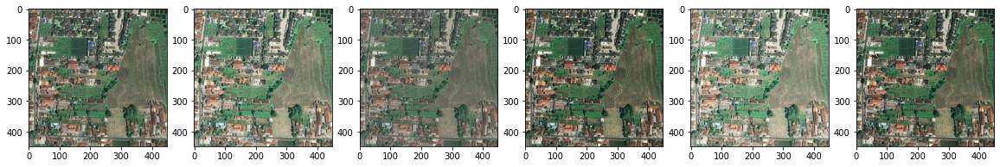

---------------------------------------- : ----------------------------------------
                         Transform Image : Light (High)
                   Light, "max_lighting" : 0.95 (between 0 and 0.95 light exposure for each image)
---------------------------------------- : ----------------------------------------


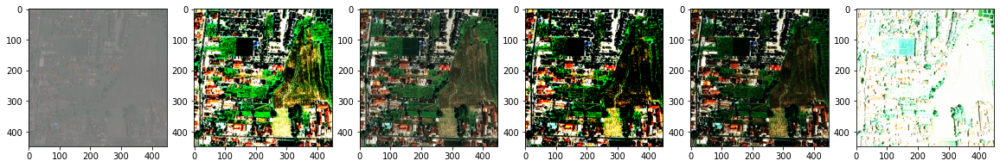

In [ ]:
# flip faces it (run it repeatly)
wallaby.draw_transform_light(wallaby.fetch_random_img(wallaby.img_path.joinpath("satellite")))

- For satellite photos, as said before, if the use-case is to classify multi-label landmarks, then too much light will give the effects of a hazy day. “Hazy” is one of the multi-label, so using the light-effect option might provide a false-positive. 

## 2.12 | Put It All Together

- From the above five augmentation features, Wallaby will define the optimal combined values for the transformation on each image data-set. 

- The coding is super simple. It is the experience from running the code-cells repeatedly that counts. Is tilting 0.3 factor better than 0.25 or 0.35 for faces? There is no mathematically calculated optimal value. It is a judgment call, and it varies from person to person. The salient point is coding-it gives data scientists a common platform to discuss the differences logically.

- A Jupyter notebook is a superior tool to other media, such as blogs, whitepapers, video-streamings, or podcasts. It is because Jupyter notebook enables interactivity both in real-time or in self-paced mode. 

- For example, Wallaby stated that 0.245 is the optimal value for light-effect in the cityscape image set. You can repeatedly run the code-cells to verify Wallaby’s claim. You should disagree with Wallaby because he is a dog, and canine can only see the blue-and-green color shade. :-) 

- Whitepapers, blogs, or video-streamings can not facilitate the above interaction, but Jupyter notebook is made for the above interactivities. 

- Wallaby will draw the data-bunch for each image data set. There is an option to run on or off the transformation feature. 


In [ ]:
# final transform
@add_method(AUD3)
def fetch_final_transform(self):
  self.final_transform_faces = fastai.vision.get_transforms(do_flip=True, flip_vert=False, p_affine=0.75,
    max_rotate=45,max_warp=0.15,max_zoom=1.3, max_lighting=0, p_lighting=0)
  self.final_transform_cityscape = fastai.vision.get_transforms(do_flip=True, flip_vert=False, p_affine=0.75,
    max_rotate=0,max_warp=0,max_zoom=1.4, max_lighting=0.4, p_lighting=.60)
  self.final_transform_landscape = fastai.vision.get_transforms(do_flip=True, flip_vert=False, p_affine=0.75,
    max_rotate=25,max_warp=0.15,max_zoom=1.3, max_lighting=0.3, p_lighting=0.70)
  self.final_transform_satellite = fastai.vision.get_transforms(do_flip=True, flip_vert=True, p_affine=0.75,
    max_rotate=45,max_warp=0,max_zoom=0, max_lighting=0, p_lighting=0)
  self.batch_size = 64
  return
#
#
# draw augmented image databunch
@add_method(AUD3)
def draw_augmented_databunch(self,img_path, tfms,is_tfms=True):
  # set up
  img = self.fetch_random_img(img_path)
  files = numpy.array(self.img_list)
  numpy.random.shuffle(files)
  # tfms_index = 0 # zero = train, one = valid
  canvas, pic = self.fetch_graph_canvas(row=8,col=8,size=(16,16))
  #
  idx = 0
  for j in range(8):
    for i in range(8):
      if (is_tfms == True):
        pil_img = self._fetch_transform_img(files[idx],tfms)
      else:
        pil_img = matplotlib.pyplot.imread(files[idx])
      pic[j,i].imshow(pil_img)
      pic[i,j].set_axis_off()
      idx = idx + 1
  #
  # the "block=False" forces the next print statement to wait for the image to show
  # i.e. the images will not display last (it display in the intended sequence.)
  #matplotlib.pyplot.show(block=False)
  canvas.subplots_adjust(wspace=0, hspace=0)
  canvas.show()
  return

In [ ]:
# fetch final transformation optimal value
wallaby.fetch_final_transform()

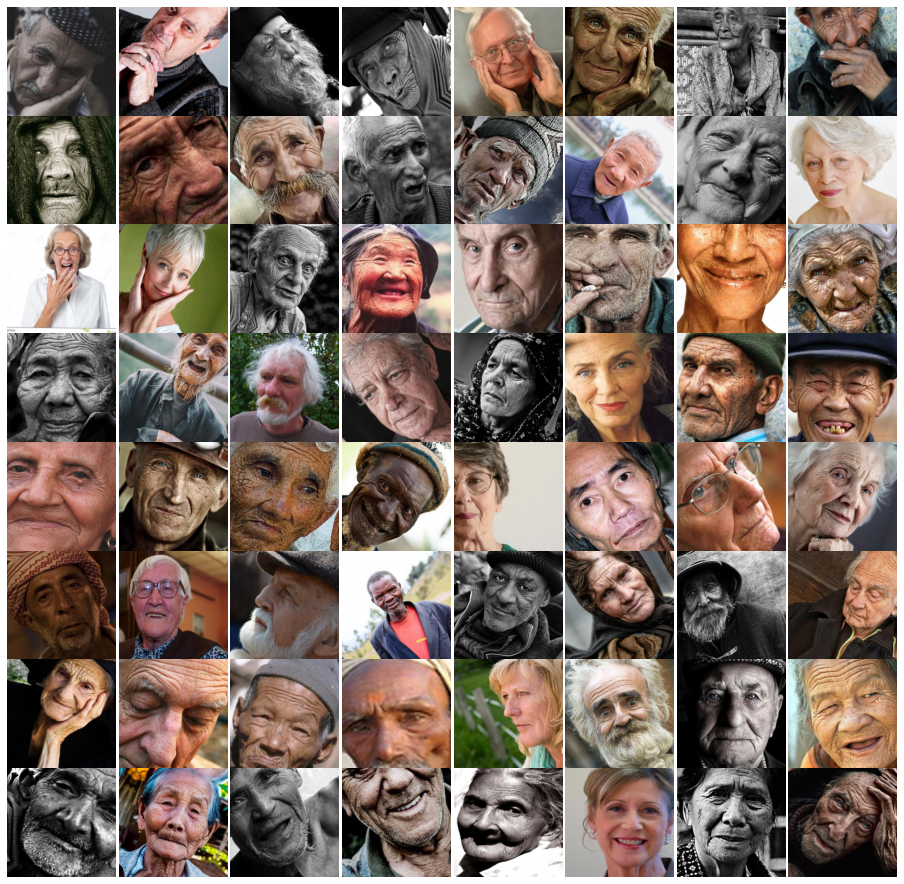

In [ ]:
# draw faces databunch (run it repeatly)
wallaby.img_list = None
wallaby.draw_augmented_databunch(wallaby.img_path.joinpath("faces"),wallaby.final_transform_faces)

- That is super cool. Every time Wallaby runs the above code-cells, the system displays a different set of images. The system shuffled the pictures as a data-bunch would request it, but the central point is that the system randomly transformed each photo based on the overall set parameters. Therefore, Wallaby can train the ANN model with more epochs and not be over-fitting. 

- What are your optimal values for the face image set? Are they different from Wallaby’s parameters?


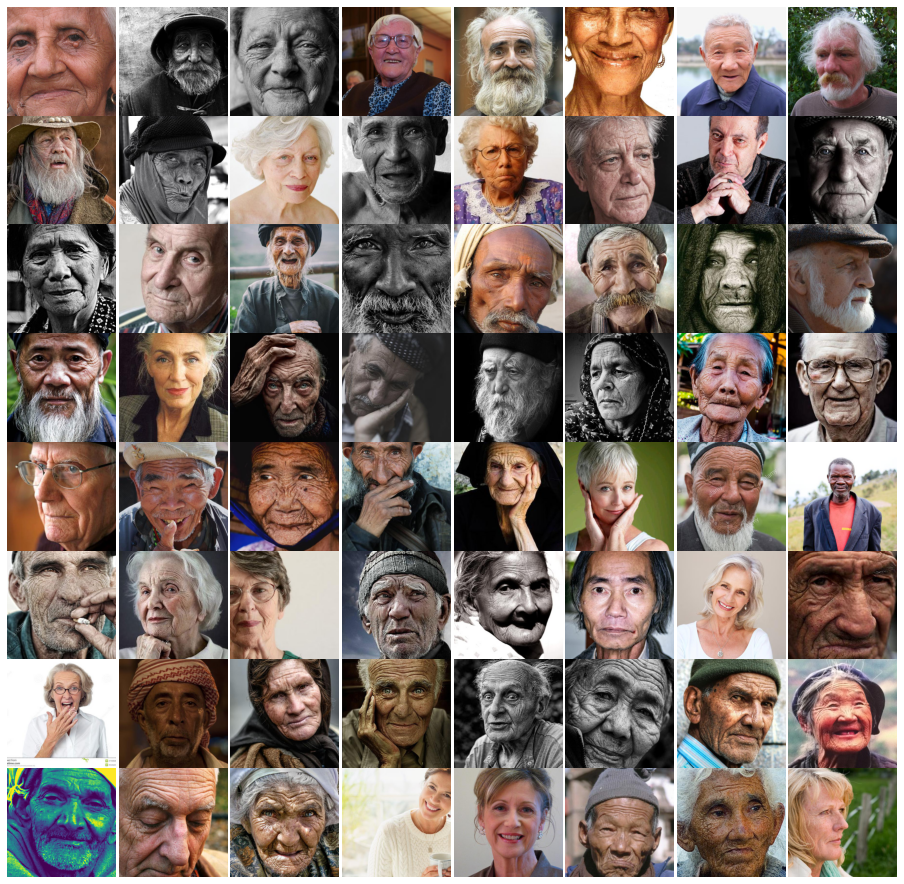

In [ ]:
wallaby.draw_augmented_databunch(wallaby.img_path.joinpath("faces"),wallaby.final_transform_faces,is_tfms=False)

- Wallaby can run the above-code cells with “is_transform=False” so that he can view the data-bunch images as-is. It is a good practice to check that Wallaby has not compromised the subject in the data set.

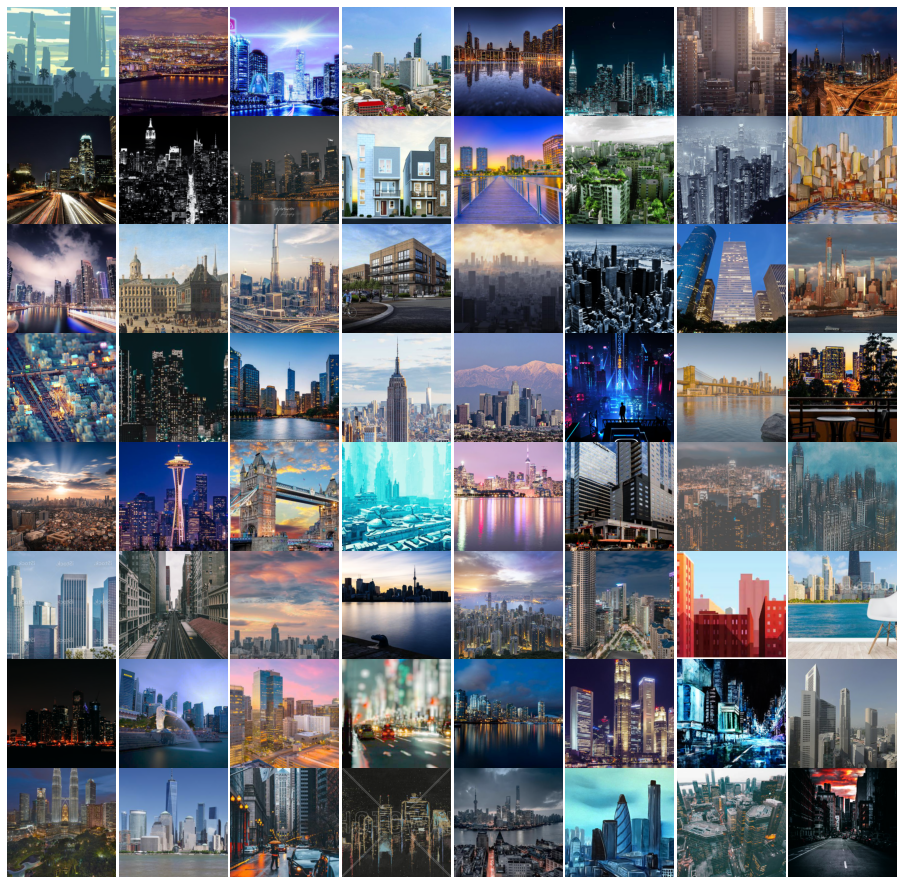

In [ ]:
# draw faces databunch (run it repeatly)
wallaby.img_list = None
wallaby.draw_augmented_databunch(wallaby.img_path.joinpath("cityscape"),wallaby.final_transform_cityscape)

- For cityscape data-bunch, Wallaby ran the above code-cells a dozen times, and he can’t see any differences, but that is the desired outcome. The data set is augmented to increase the size by a factor of 12 or more, and to a canine (and human) view, the system does not change the integrity of the data set.

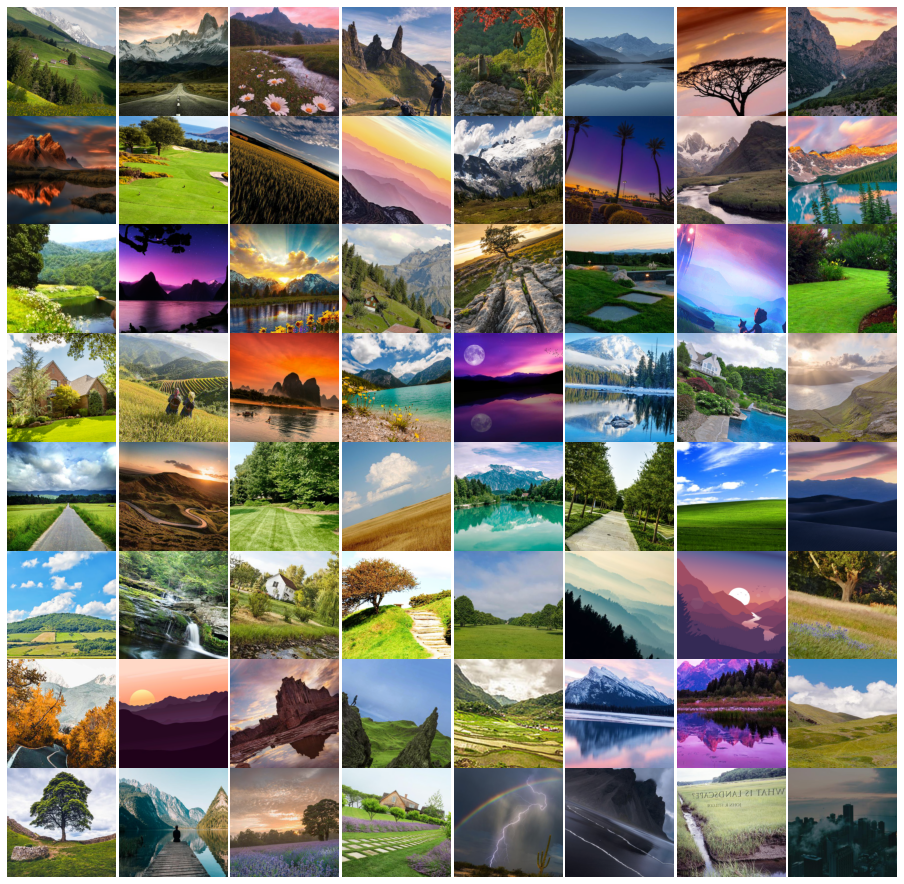

In [ ]:
# draw faces databunch (run it repeatly)
wallaby.img_list = None
wallaby.draw_augmented_databunch(wallaby.img_path.joinpath("landscape"),wallaby.final_transform_landscape)

- For the landscape data-bunch, Wallaby may go overboard with the image transformation. But it is nature, and weirder things can happen. Who knows how a canine perceives a tree or a lake?

- Do you agree with Wallaby?


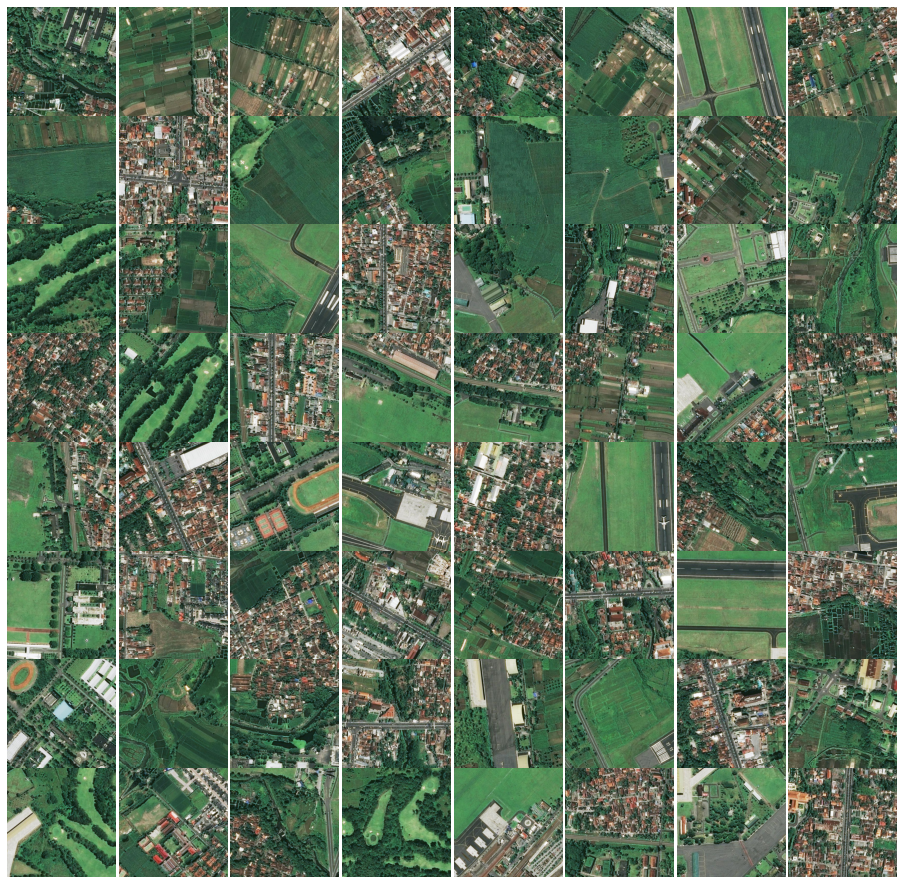

In [ ]:
# draw faces databunch (run it repeatly)
wallaby.img_list = None
wallaby.draw_augmented_databunch(wallaby.img_path.joinpath("satellite"),wallaby.final_transform_satellite)

- For the satellite data-bunch, Wallaby chooses safe parameters. It still looks like a drunken crop-duster taking aerial photographs. Magpiena assured Wallaby that is how she sees the world. No wonder that dog and bird do not get along.

- Wallaby did turn the transform feature on and off for the data-bunch, but that doesn’t help him. Birds are crazy, but not as crazy as cats. :-)


## 2.13 | Wrap Up 

- The “AUD3” journey begins with Wallaby invites Monty because he is an expert in cleaning data. Wallaby directs Monty to download the four image data set, the older adult faces, the cityscape, the landscape, and the aerial satellite photos. 

- Even though data augmentation does not require the pictures to be squared, centered, and uniform in size, Wallaby, insists on having all images resized to be 448x448 pixel, centered, and normalized the file names. He likes being organized and tidy.

- The goal of data augmentation is to increase the number of images for training an ANN model. The fundamental truth is that the more images available for training, the higher the accuracy rate and the lower the chance for overfitting. 

- Wallaby has fun with the “flip, warp, tilt, zoom, and light-effect” augmentation feature. Wallaby writes the code to illustrate each effect fully. He plays with it over and over again. He increases the parameters a little bit then decreases them a little bit. He runs it repeatedly until he has a firm grasped of the effect on the photos. 

- The code is so easy to write, so the effort is mostly in viewing the photos and discerning how much flip, warp, tilt, zoom, and light-effect would be sufficient. The choices of which feature to use and how much is subjective. The ANN model goals and use-cases dictate which augmentation features are appropriate, but how-much is based on the data scientist. 

- Wrapping up the journey, Wallaby draws the data-bunch for each image data set with the optimal transformation parameters and without it. He encourages everyone to hack the Jupyter notebook, add their images, and choose the augmentation parameters. 

- Wallaby notices there is a lot of common sense used throughout the journey. Assign from the coding, math, and terminology, there is no magic, and like most professions, common sense backed by data is the best policy. 

- Fun, interactivity, and partner are the requirements for a good hike, as well as for an effective learning session. That is why Wallaby is a trained hiking dog. He is not a tea-cut dog or a pampered family dog. He likes hiking, listening to (digital) commands, respecting nature, and knowing not to harm wildlife unnecessarily. 

- Wallaby is looking forward to the next journey and hopes to see you again.



In [18]:
# dance
wallaby.dance_happy()

        _=,_
    o_/6 /#\
    \__ |##/
     ='|--\
       /   #'-.
       \#|_   _'-. /
        |/ \_( # |" 
       C/ ,--___/

---------------------------------------- : ----------------------------------------


><center><h2><i>The End.</i></h2></center>

# 3 |-- Conclusion




- AUD3 is a visual journey with little coding and math. It is fun to write and code. Data augmentation substantially impacts the ANN model accuracy, yet not many data scientists or AI students are using it. 

- Jupyter Notebook is the best tool for learning. It enables interactivity and individuality. Once you internalize the knowledge, concepts, and methods by doing it via coding or writing, you have a solid foundation to move forward. You may discover a new nugget of knowledge or an epiphany. 

- As the author, I layout the journey beginning, middle, and ending, but through Jupyter Notebook, the readers can, and even encourage to, hack the story by adding notes, modify the codes, or write the new detour. 

- For example, after I preview the AUD3 notebook to a friend, he took the notebook and expand it to include the “inject known noises” image augmentation feature. Assuming a scenario where the ANN must read the street road sign correctly, e.g., stop sign, 40 MPH sign, merge left sign, and so on. He wants to randomly add graffiti, stickers, or buckshot to the road sign pictures. Therefore, during the real-world application, the ANN would recognize the road signs correctly.

- I wish that his company allow him to publish his Jupypter notebook. If he posted it on a whitepaper, company blog, or article, it is like giving me a car without an engine. 

- Incidentally, the “inject known noises” touches on a salient point of data bias. Without knowing the full scope, there are “known” biases in the rode sign ANN project. For one, it biases for clean cities with pristine road signs, e.g., Frankfurt or Copenhagen. The system will fail in my hometown of San Francisco or Oakland, California.

- There you have it. We found a scenario where data scientists could use data augmentation to lessen the data biases. 

- Data scientists are not the only ones that have an epiphany. As Wallaby said, the AUD3 journey is full of common sense approaches backed by data. Any gentle readers might have a new idea about data augmentation. If you do and are not comfortable with coding, contact me via LinkedIn, and maybe my colleagues or I could help you.

- The demystify AI series is for having fun sharing concepts and code with colleagues and AI students, but more than that. It is a peek into a daily workaday problem of AI scientists. 

- Not all AI programmers work on Google, Facebook, or government Defense Department large-scale omnipotent AI. If we are in the Star Trek universe, these are not the captain or chief engineer’s logs. They are the logs of an ensign in the lower deck scrubbing Jeffrey tubes.

- I hope to see you on the next Demystify AI journey.



In [27]:
# black sheep
wallaby.draw_black_sheep()


_________________       _       _       _       _       _       _       _ 
______________-(_)-  _-(_)-  _-(_)-  _-(")-  _-(_)-  _-(_)-  _-(_)-  _-(_)- 
___________`(___)  `(___)  `(___)  `(###)  `(___)  `(___)  `(___)  `(___) 
____________// \\   // \\   // \\   // \\   // \\   // \\   // \\   // \\ 

---------------------------------------- : ----------------------------------------
                                 bye'aaa : bye'aaa


# 4 |-- Demystify AI Series

1. ["Demystify Neural Network NLP Input-data and Tokenizer" on LinkedIn](https://www.linkedin.com/pulse/demystify-neural-network-nlp-input-data-tokenizer-duc-haba/) | on [GitHub](https://github.com/duchaba/demystify_nlp_data_tokenizer_d3tz/blob/main/NLP_Data_Tokenizer_d3tz.ipynb)

2. ["Python 3D Visualization​" on LinkedIn](https://www.linkedin.com/pulse/python-3d-visualization-hackable-step-by-step-jupyter-duc-haba/) | on [GitHub](https://github.com/duchaba/python_3D_visualization_p3vi/blob/master/Python_3D_Graphs_p3vi.ipynb)

3. ["Demystify Python 2D Charts" on LinkedIn](https://www.linkedin.com/pulse/demystify-python-charts-hackable-step-by-step-jupyter-duc-haba/) | on [GitHub](https://github.com/duchaba/python_graphs_p2go/blob/master/Python_Graphs_p2go.ipynb)

4. ["Norwegian Blue Parrot, The "k2fa"​ AI" on LinkedIn](https://www.linkedin.com/pulse/norwegian-blue-parrot-k2fa-ai-duc-haba/) | on [K2fa-Website](https://nbp3-webclient-2020.web.app/)

5. ["The Texas Two-Step, The Hero of Digital Chaos" on LinkedIn](https://www.linkedin.com/pulse/texas-two-step-hero-digital-chaos-duc-haba/)

In [ ]:
# end of jupyter notebook